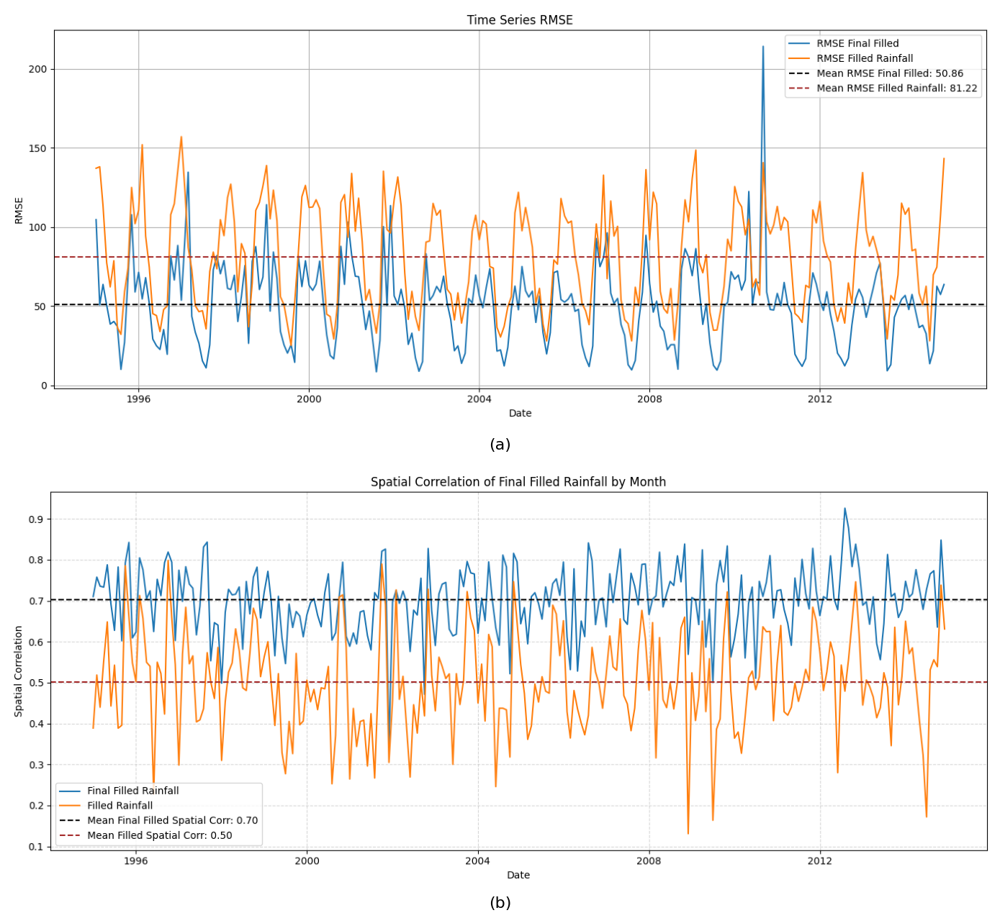

In [2]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img1 = mpimg.imread('rmse_ratarata.png')
img2 = mpimg.imread('korelasi_spasial.png')

fig, axes = plt.subplots(2, 1, figsize=(14, 13))

axes[0].imshow(img1)
axes[0].axis('off')

axes[1].imshow(img2)
axes[1].axis('off')

plt.tight_layout()

# Add labels below each subplot using fig.text
fig.text(0.5, 0.51, '(a)', ha='center', va='top', fontsize=16)
fig.text(0.5, 0.02, '(b)', ha='center', va='top', fontsize=16)

plt.show()

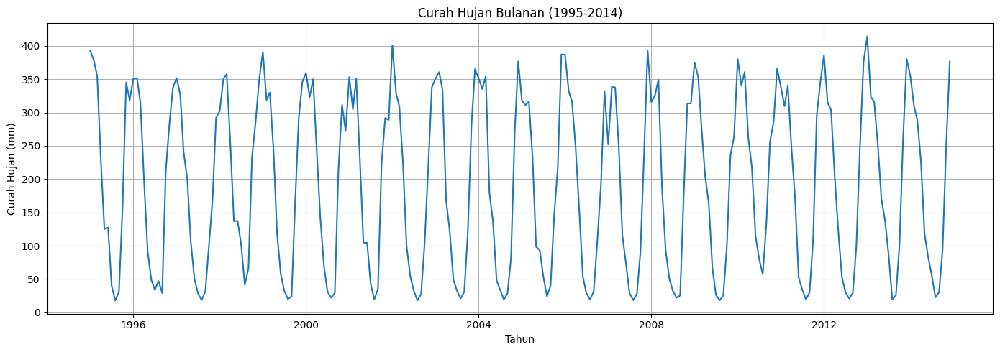

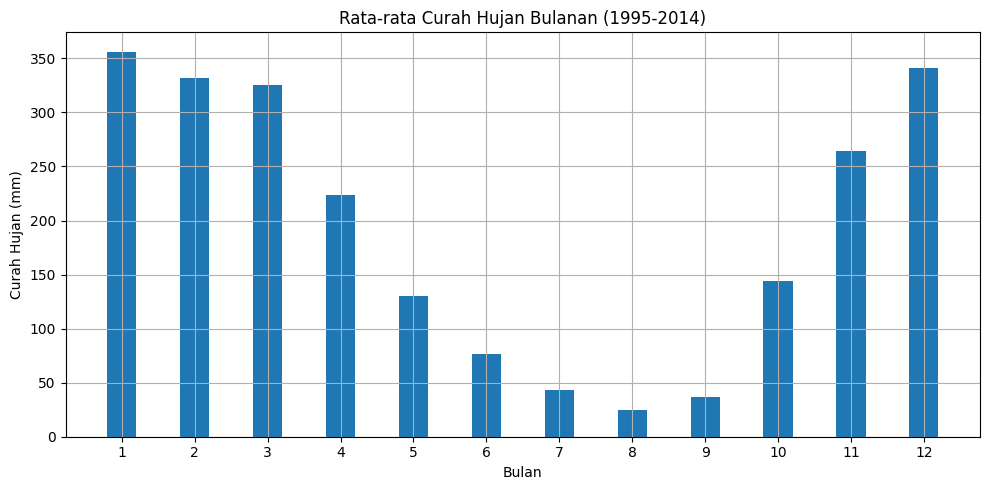

In [18]:
import pandas as pd
import matplotlib.pyplot as plt

# Assume df has columns: 'year', 'month', 'final_rainfall'
#years = [1999, 2000]  # integers, not strings
df = pd.read_csv("final_station_mswp.csv")

# 1. Monthly timeseries (mean rainfall per month across all stations)
df['date'] = pd.to_datetime(df[['year', 'month']].assign(day=1))
#df = df[df['year'].isin(years)]  # filter by year

monthly_means = df.groupby('date')['final_rainfall'].mean()

plt.figure(figsize=(14, 5))
plt.plot(monthly_means.index, monthly_means.values)
plt.title('Curah Hujan Bulanan (1995-2014)')
plt.xlabel('Tahun')
plt.ylabel('Curah Hujan (mm)')
plt.grid(True)
plt.tight_layout()
plt.show()

# 2. Mean of same month for all years (climatology)
climatology = df.groupby('month')['final_rainfall'].mean()

plt.figure(figsize=(10, 5))
plt.bar(climatology.index, climatology.values, width=0.4)
plt.title('Rata-rata Curah Hujan Bulanan (1995-2014)')
plt.xlabel('Bulan')
plt.ylabel('Curah Hujan (mm)')
plt.xticks(range(1, 13))
plt.grid(True)
plt.tight_layout()
plt.show()

In [4]:
index = pd.read_csv("data_dmi_nino.csv",)
index['Date'] = pd.to_datetime(index['Date'])
index

,Date,DMI,NINA34
0,1995-01-01,0.140,1.10
1,1995-02-01,0.164,0.87
2,1995-03-01,-0.050,0.49
3,1995-04-01,-0.221,0.27
4,1995-05-01,-0.251,0.03
...,...,...,...
235,2014-08-01,-0.372,0.14
236,2014-09-01,-0.145,0.37
237,2014-10-01,0.141,0.48
238,2014-11-01,0.010,0.89


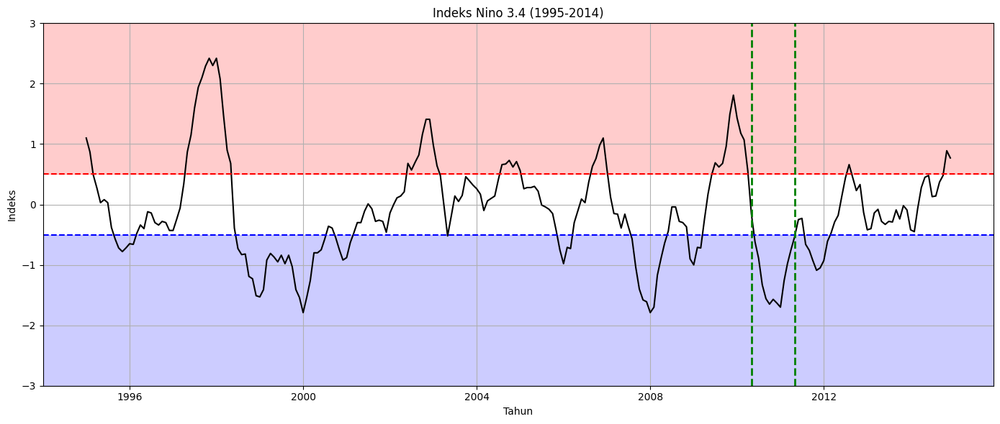

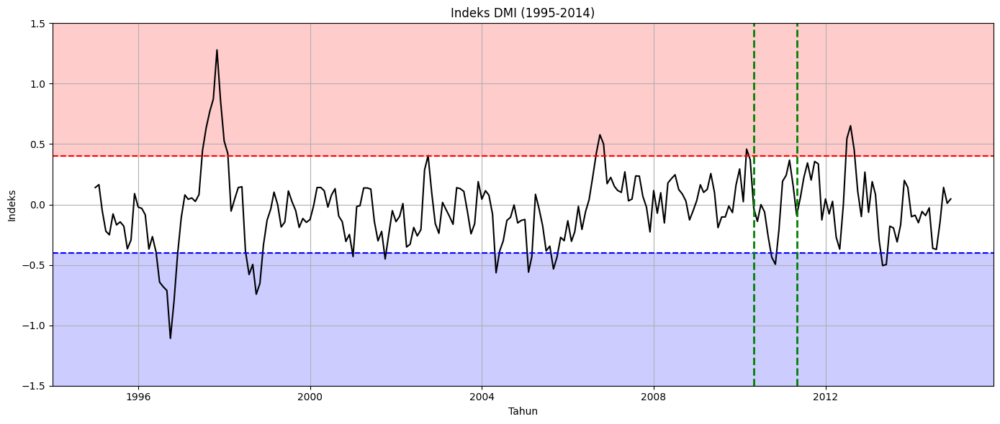

In [12]:
highlight_1 = pd.to_datetime('2010-05-01')
highlight_2 = pd.to_datetime('2011-05-01')

plt.figure(figsize=(14, 6))
plt.plot(index['Date'], index['NINA34'], color='black')
plt.title('Indeks Nino 3.4 (1995-2014)')
plt.xlabel('Tahun')
plt.ylabel('Indeks')
plt.ylim(-3, 3)

plt.axhline(-0.5, color='blue', linestyle='--')
plt.axhspan(-0.5, plt.ylim()[0], color='blue', alpha=0.2)
plt.axhline(0.5, color='red', linestyle='--')
plt.axhspan(0.5, plt.ylim()[1], color='red', alpha=0.2)
plt.axvline(highlight_1, color='green', linestyle='--', linewidth=2, label='09-2010')
plt.axvline(highlight_2, color='green', linestyle='--', linewidth=2, label='09-2010')
plt.grid(True)
plt.tight_layout()
plt.show()

plt.figure(figsize=(14, 6))
plt.plot(index['Date'], index['DMI'], color='black')
plt.title('Indeks DMI (1995-2014)')
plt.xlabel('Tahun')
plt.ylabel('Indeks')
plt.ylim(-1.5, 1.5)

plt.axhline(-0.4, color='blue', linestyle='--')
plt.axhspan(-0.4, plt.ylim()[0], color='blue', alpha=0.2)
plt.axhline(0.4, color='red', linestyle='--')
plt.axhspan(0.4, plt.ylim()[1], color='red', alpha=0.2)
plt.axvline(highlight_1, color='green', linestyle='--', linewidth=2, label='09-2010')
plt.axvline(highlight_2, color='green', linestyle='--', linewidth=2, label='09-2010')
plt.grid(True)
plt.tight_layout()
plt.show()

## Result-Dataframe

In [175]:
import numpy as np
import pandas as pd
import geopandas as gpd
import os

ok = pd.read_csv("OK_results/Masked/OK_merged_results-Exponential.csv")
uk = pd.read_csv("UK_results/Masked/UK_merged_results.csv")
rbf = pd.read_csv("RBFN_results/Masked/RBFN_merged_results.csv")

# If not, load java shapefile and filter to Java bounding box
indo = gpd.read_file("Jawa1.shp")
minx, miny, maxx, maxy = 105, -8.8, 115, -5.8
java = indo.cx[minx:maxx, miny:maxy]

# Create GeoDataFrame from interp_df grid points
ok_results = gpd.GeoDataFrame(
    ok,
    geometry=gpd.points_from_xy(ok['lon'], ok['lat']),
    crs=java.crs
)
ok_results = gpd.sjoin(ok_results, java, predicate='within', how='inner')
ok_results = ok_results.drop(columns=['geometry', 'index_right'], errors='ignore')

uk_results = gpd.GeoDataFrame(
    uk,
    geometry=gpd.points_from_xy(uk['lon'], uk['lat']),
    crs=java.crs
)
uk_results = gpd.sjoin(uk_results, java, predicate='within', how='inner')
uk_results = uk_results.drop(columns=['geometry', 'index_right'], errors='ignore')
rbf_results = gpd.GeoDataFrame(
    rbf,
    geometry=gpd.points_from_xy(rbf['lon'], rbf['lat']),
    crs=java.crs
)
rbf_results = gpd.sjoin(rbf_results, java, predicate='within', how='inner')
rbf_results = rbf_results.drop(columns=['geometry', 'index_right'], errors='ignore')

# Save to CSV
output_ok = "OK_results/Masked/"
output_uk = "UK_results/Masked/"
output_rbf = "RBFN_results/Masked/"
#os.makedirs(output_folder, exist_ok=True)
ok_results.to_csv(os.path.join(output_ok, "OK_results_Jawa.csv"), index=False)
uk_results.to_csv(os.path.join(output_uk, "UK_results_Jawa.csv"), index=False)
rbf_results.to_csv(os.path.join(output_rbf, "RBFN_results_Jawa.csv"), index=False)
#print(f"Masked kriging grid saved to {os.path.join(output_folder, 'kriging_interp_masked.csv')}")"""

In [176]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

#df_ok = pd.read_csv("OK_results/Masked/kriging_results_masked.csv")
#df_uk = pd.read_csv("UK_results/Masked/kriging_results_masked.csv")
#df_rbf = pd.read_csv("RBF_results/Masked/rbf_results_masked.csv")

df_ok = pd.read_csv("OK_results/Masked/OK_results_Jawa.csv")
df_uk = pd.read_csv("UK_results/Masked/UK_results_Jawa.csv")
df_rbf = pd.read_csv("RBFN_results/Masked/RBFN_results_Jawa.csv")

df_ref = df_ok.drop(columns='rainfall')

indo = gpd.read_file("Jawa_only.shp")
minx, miny, maxx, maxy = 105, -8.8, 115, -5.8
java = indo.cx[minx:maxx, miny:maxy]

In [180]:
vmax = df_ok['rainfall'].max()
vmax_uk = df_uk['rainfall'].max()
vmax_rbf = df_rbf['rainfall'].max()
vmax = max(vmax, vmax_uk, vmax_rbf)
vmax = np.ceil(vmax / 100) * 100

### Outlier

In [203]:
perc95_ok = df_ok['rainfall'].quantile(0.95)
perc95_uk = df_uk['rainfall'].quantile(0.95)
perc95_rbf = df_rbf['rainfall'].quantile(0.95)

perc95_mswep = df_ok['pr_mswep'].quantile(0.95)
perc95_chirps = df_ok['pr_chirps'].quantile(0.95)
perc95_ref = max(perc95_mswep, perc95_chirps)

#perc95_ok = max(perc95_ok, perc95_mswep)
#perc95_uk = max(perc95_uk, perc95_mswep)
#perc95_rbf = max(perc95_rbf, perc95_mswep)

In [204]:
# Find outliers above 95th percentile for each (year, month)
outlier_points = []

# Loop over all unique (year, month) pairs in the data
for (year, month), df_ym in df_ok.groupby(['year', 'month']):
    if df_ym.empty:
        continue
    mask = (df_ym[['rainfall']] > perc95_ok).any(axis=1)
    outliers = df_ym.loc[mask, ['year', 'month', 'lon', 'lat', 'rainfall', 'pr_mswep', 'pr_chirps']]
    outlier_points.append(outliers)

# Combine all outliers into a single DataFrame
outlier_df_ok = pd.concat(outlier_points, ignore_index=True)

# Show or save the result
#outlier_df_ok

In [205]:
# Find outliers above 95th percentile for each (year, month)
outlier_points = []

# Loop over all unique (year, month) pairs in the data
for (year, month), df_ym in df_uk.groupby(['year', 'month']):
    if df_ym.empty:
        continue
    # Select rows where any of the three columns is above the 95th percentile of 'rainfall'
    mask = (df_ym[['rainfall']] > perc95_uk).any(axis=1)
    outliers = df_ym.loc[mask, ['year', 'month', 'lon', 'lat', 'rainfall', 'pr_mswep', 'pr_chirps']]
    outlier_points.append(outliers)

# Combine all outliers into a single DataFrame
outlier_df_uk = pd.concat(outlier_points, ignore_index=True)

# Show or save the result
#outlier_df_uk

In [206]:
# Find outliers above 95th percentile for each (year, month)
outlier_points = []

# Loop over all unique (year, month) pairs in the data
for (year, month), df_ym in df_rbf.groupby(['year', 'month']):
    if df_ym.empty:
        continue
    # Select rows where any of the three columns is above the 95th percentile of 'rainfall'
    mask = (df_ym[['rainfall']] > perc95_rbf).any(axis=1)
    outliers = df_ym.loc[mask, ['year', 'month', 'lon', 'lat', 'rainfall', 'pr_mswep', 'pr_chirps']]
    outlier_points.append(outliers)

# Combine all outliers into a single DataFrame
outlier_df_rbf = pd.concat(outlier_points, ignore_index=True)

# Show or save the result
#outlier_df_rbf

In [207]:
# Find outliers above 95th percentile for each (year, month)
outlier_points = []

# Loop over all unique (year, month) pairs in the data
for (year, month), df_ym in df_ref.groupby(['year', 'month']):
    if df_ym.empty:
        continue
    #perc95_mix = df_ym['rainfall'].quantile(0.95)
    #perc95_mswep = df_ym['pr_mswep'].quantile(0.95)
    #perc95_chirps = df_ym['pr_chirps'].quantile(0.95)
    #perc95_rbf = perc95_rf
    #perc95_ref = max(perc95_mswep, perc95_chirps)
    # Select rows where any of the three columns is above the 95th percentile of 'rainfall'
    mask = (df_ym[['pr_mswep', 'pr_chirps', 'pr_chirps_qm']] > perc95_ref).any(axis=1)
    outliers = df_ym.loc[mask, ['year', 'month', 'lon', 'lat', 'pr_mswep', 'pr_chirps', 'pr_chirps_qm']]
    outlier_points.append(outliers)

# Combine all outliers into a single DataFrame
outlier_df_ref = pd.concat(outlier_points, ignore_index=True)

# Show or save the result
#utlier_df_ref

### Quantitatif of Extreme

In [208]:
count_ok = df_ok.groupby(['year', 'month'])['rainfall'].count().reset_index()
count_uk = df_uk.groupby(['year', 'month'])['rainfall'].count().reset_index()
count_rbf = df_rbf.groupby(['year', 'month'])['rainfall'].count().reset_index()

count_ok_out = outlier_df_ok.groupby(['year', 'month'])['rainfall'].count().reset_index()
count_uk_out = outlier_df_uk.groupby(['year', 'month'])['rainfall'].count().reset_index()
count_rbf_out = outlier_df_rbf.groupby(['year', 'month'])['rainfall'].count().reset_index()

perc_ex_ok = count_ok_out['rainfall'] / count_ok['rainfall']
perc_ex_uk = count_uk_out['rainfall'] / count_uk['rainfall']
perc_ex_rbf = count_rbf_out['rainfall'] / count_rbf['rainfall']

print(f"Percentage of outliers in OK results: {(perc_ex_ok.mean() * 100).round(1)}%")
print(f"Percentage of outliers in UK results: {(perc_ex_uk.mean() * 100).round(1)}%")
print(f"Percentage of outliers in RBF results: {(perc_ex_rbf.mean() * 100).round(1)}%")

Percentage of outliers in OK results: 9.5%
Percentage of outliers in UK results: 10.4%
Percentage of outliers in RBF results: 11.4%


In [210]:
OK_ex = outlier_df_ok.copy()
UK_ex = outlier_df_uk.copy()
RBF_ex = outlier_df_rbf.copy()
ref_ex = outlier_df_ref.copy()

def pod_far_csi(obs, sim, threshold):
    obs = np.asarray(obs)
    sim = np.asarray(sim)
    hits = np.sum((obs >= threshold) & (sim >= threshold))
    misses = np.sum((obs >= threshold) & (sim < threshold))
    false_alarms = np.sum((obs < threshold) & (sim >= threshold))
    pod = hits / (hits + misses) if (hits + misses) > 0 else np.nan
    far = false_alarms / (hits + false_alarms) if (hits + false_alarms) > 0 else np.nan
    csi = hits / (hits + misses + false_alarms) if (hits + misses + false_alarms) > 0 else np.nan
    return pod, far, csi

# For OK
pod_ok_mswep, far_ok_mswep, csi_ok_mswep = pod_far_csi(OK_ex['pr_mswep'], OK_ex['rainfall'], threshold=perc95_ok)
pod_ok_chirps, far_ok_chirps, csi_ok_chirps = pod_far_csi(OK_ex['pr_chirps'], OK_ex['rainfall'], threshold=perc95_ok)

# For UK
pod_uk_mswep, far_uk_mswep, csi_uk_mswep = pod_far_csi(UK_ex['pr_mswep'], UK_ex['rainfall'], threshold=perc95_uk)
pod_uk_chirps, far_uk_chirps, csi_uk_chirps = pod_far_csi(UK_ex['pr_chirps'], UK_ex['rainfall'], threshold=perc95_uk)

# For RBF
pod_rbf_mswep, far_rbf_mswep, csi_rbf_mswep = pod_far_csi(RBF_ex['pr_mswep'], RBF_ex['rainfall'], threshold=perc95_rbf)
pod_rbf_chirps, far_rbf_chirps, csi_rbf_chirps = pod_far_csi(RBF_ex['pr_chirps'], RBF_ex['rainfall'], threshold=perc95_rbf)

# For RBF
pod_ref_mswep, far_ref_mswep, csi_ref_mswep = pod_far_csi(ref_ex['pr_mswep'], ref_ex['pr_chirps'], threshold=perc95_ref)
pod_ref_chirps, far_ref_chirps, csi_ref_chirps = pod_far_csi(ref_ex['pr_chirps'], ref_ex['pr_mswep'], threshold=perc95_ref)
pod_ref_mswep_qm, far_ref_mswep_qm, csi_ref_mswep_qm = pod_far_csi(ref_ex['pr_mswep'], ref_ex['pr_chirps_qm'], threshold=perc95_ref)
pod_ref_chirps_qm, far_ref_chirps_qm, csi_ref_chirps_qm = pod_far_csi(ref_ex['pr_chirps_qm'], ref_ex['pr_mswep'], threshold=perc95_ref)

print("OK MSWEP:   POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_ok_mswep, far_ok_mswep, csi_ok_mswep))
print("OK CHIRPS:  POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_ok_chirps, far_ok_chirps, csi_ok_chirps))
print("UK MSWEP:   POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_uk_mswep, far_uk_mswep, csi_uk_mswep))
print("UK CHIRPS:  POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_uk_chirps, far_uk_chirps, csi_uk_chirps))
print("RBF MSWEP:  POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_rbf_mswep, far_rbf_mswep, csi_rbf_mswep))
print("RBF CHIRPS: POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_rbf_chirps, far_rbf_chirps, csi_rbf_chirps))
#print("REF MSWEP:  POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_ref_mswep, far_ref_mswep, csi_ref_mswep))
#print("REF CHIRPS: POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_ref_chirps, far_ref_chirps, csi_ref_chirps))
#print("REF MSWEP QM:  POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_ref_mswep_qm, far_ref_mswep_qm, csi_ref_mswep_qm))
#print("REF CHIRPS QM: POD={:.2f}, FAR={:.2f}, CSI={:.2f}".format(pod_ref_chirps_qm, far_ref_chirps_qm, csi_ref_chirps_qm))

OK MSWEP:   POD=1.00, FAR=0.30, CSI=0.70
OK CHIRPS:  POD=1.00, FAR=0.34, CSI=0.66
UK MSWEP:   POD=1.00, FAR=0.25, CSI=0.75
UK CHIRPS:  POD=1.00, FAR=0.28, CSI=0.72
RBF MSWEP:  POD=1.00, FAR=0.45, CSI=0.55
RBF CHIRPS: POD=1.00, FAR=0.47, CSI=0.53


### Plot Hit-Miss-FA

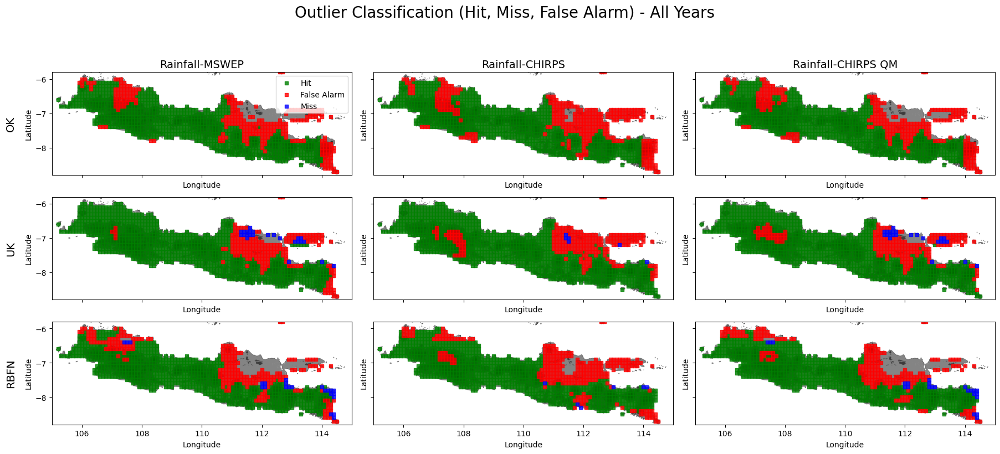

In [217]:
import matplotlib.pyplot as plt
import numpy as np

def filter_priority(hit, fa, miss):
    # Add a column to indicate type
    hit = hit.copy()
    hit['type'] = 'hit'
    fa = fa.copy()
    fa['type'] = 'fa'
    miss = miss.copy()
    miss['type'] = 'miss'
    # Combine all
    combined = pd.concat([hit, fa, miss], ignore_index=True)
    # Set priority order
    priority = {'hit': 0, 'fa': 1, 'miss': 2}
    combined['priority'] = combined['type'].map(priority)
    # Sort so hit comes first, then fa, then miss
    combined = combined.sort_values(['lon', 'lat', 'priority'])
    # Keep only the highest priority for each location
    filtered = combined.drop_duplicates(subset=['lon', 'lat'], keep='first')
    return filtered

# Calculate 95th percentile for each method
perc95s = [
    df_ok['rainfall'].quantile(0.95),
    df_uk['rainfall'].quantile(0.95),
    df_rbf['rainfall'].quantile(0.95)
]

dfs = [df_ok, df_uk, df_rbf]
method_names = ['OK', 'UK', 'RBFN']
ref_cols = [
    ('pr_mswep', 'Rainfall-MSWEP'),
    ('pr_chirps', 'Rainfall-CHIRPS'),
    ('pr_chirps_qm', 'Rainfall-CHIRPS QM')
]

fig, axes = plt.subplots(3, 3, figsize=(18, 8), sharex=True, sharey=True)
jawa_img = mpimg.imread('JAWA.png')
jawa_extent = [minx, maxx, miny, maxy]

for row, (df, method, perc95) in enumerate(zip(dfs, method_names, perc95s)):
    for col, (ref_col, ref_title) in enumerate(ref_cols):
        d = df.copy()
        threshold = perc95
        is_outlier = (d['rainfall'] > threshold) | (d[ref_col] > threshold)
        d = d[is_outlier].copy()
        hit = d[(d['rainfall'] > threshold) & (d[ref_col] > threshold)]
        miss = d[(d['rainfall'] > threshold) & (d[ref_col] <= threshold)]
        fa   = d[(d['rainfall'] <= threshold) & (d[ref_col] > threshold)]
        # Filter by priority
        filtered = filter_priority(hit, fa, miss)
        ax = axes[row, col]
        ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        # Plot by type
        if not filtered.empty:
            ax.scatter(
                filtered[filtered['type'] == 'hit']['lon'],
                filtered[filtered['type'] == 'hit']['lat'],
                c='green', marker='s', s=20, label='Hit', alpha=0.8, zorder=2
            )
            ax.scatter(
                filtered[filtered['type'] == 'fa']['lon'],
                filtered[filtered['type'] == 'fa']['lat'],
                c='red', marker='s', s=20, label='False Alarm', alpha=0.8, zorder=2
            )
            ax.scatter(
                filtered[filtered['type'] == 'miss']['lon'],
                filtered[filtered['type'] == 'miss']['lat'],
                c='blue', marker='s', s=20, label='Miss', alpha=0.8, zorder=2
            )
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        if row == 0:
            ax.set_title(ref_title, fontsize=14)
        if col == 0:
            ax.text(-0.12, 0.5, method, va='center', ha='right', rotation=90, fontsize=14, transform=ax.transAxes)
        if row == 0 and col == 0:
            ax.legend(loc='upper right', fontsize=10)

plt.suptitle('Outlier Classification (Hit, Miss, False Alarm) - All Years', fontsize=20, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.97])
#plt.savefig('Outlier_HitMissFA_AllMethods.png', dpi=300, bbox_inches='tight')
plt.show()

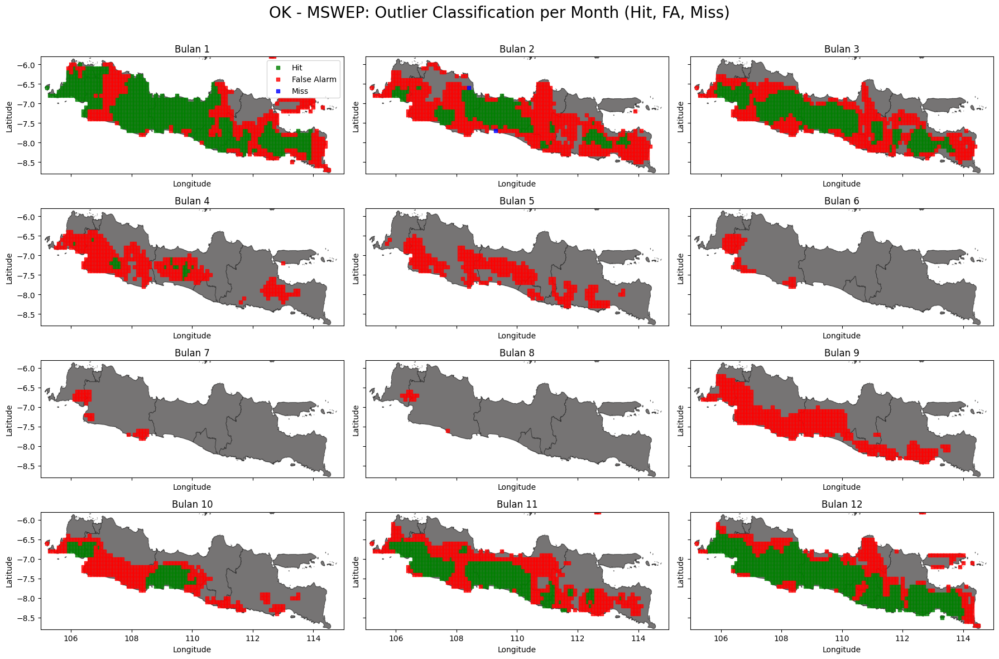

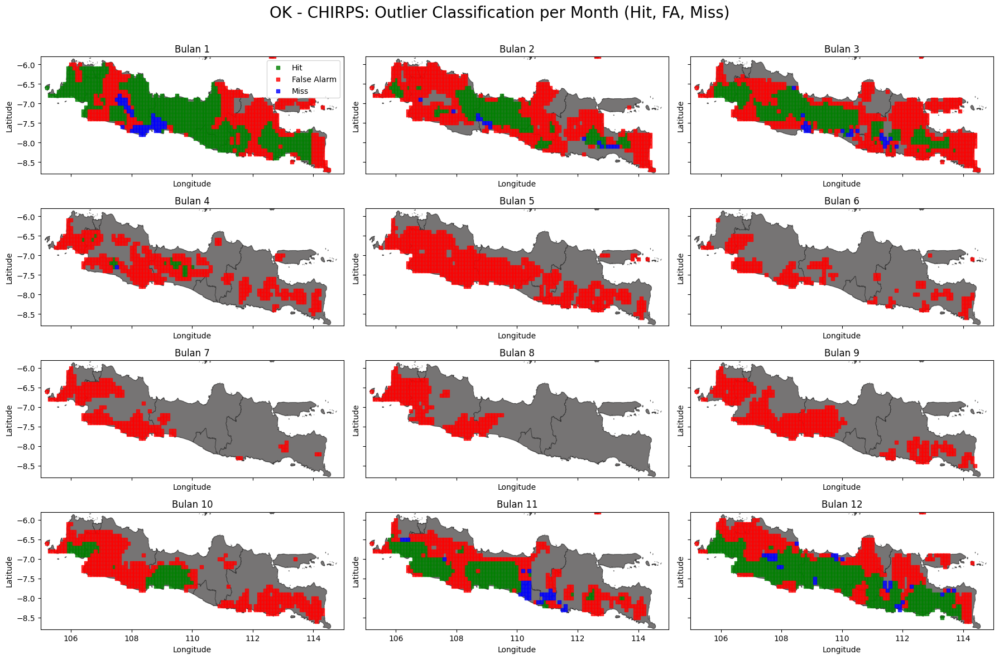

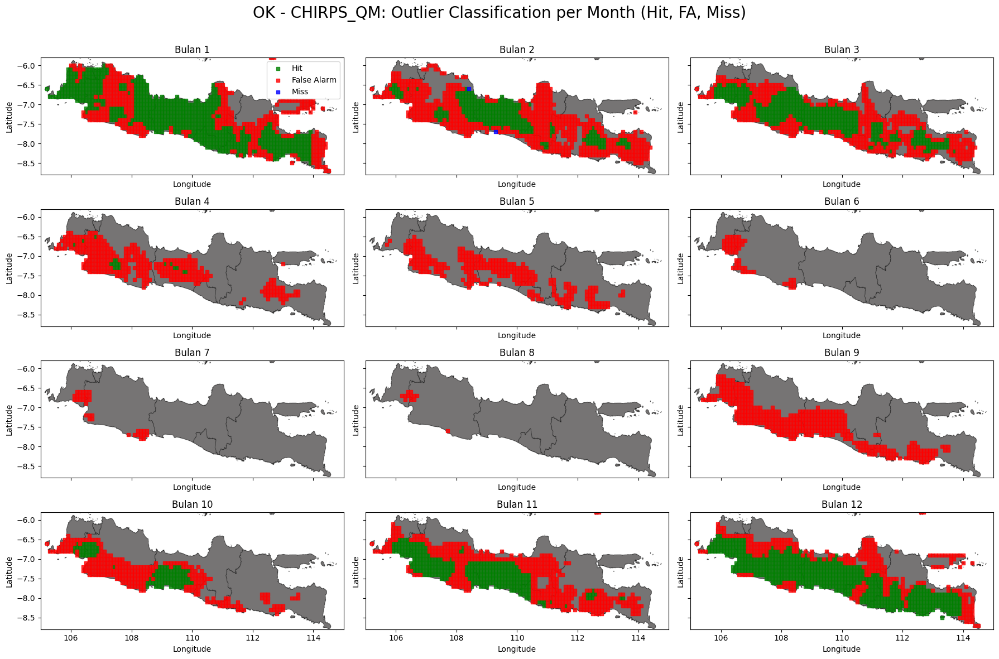

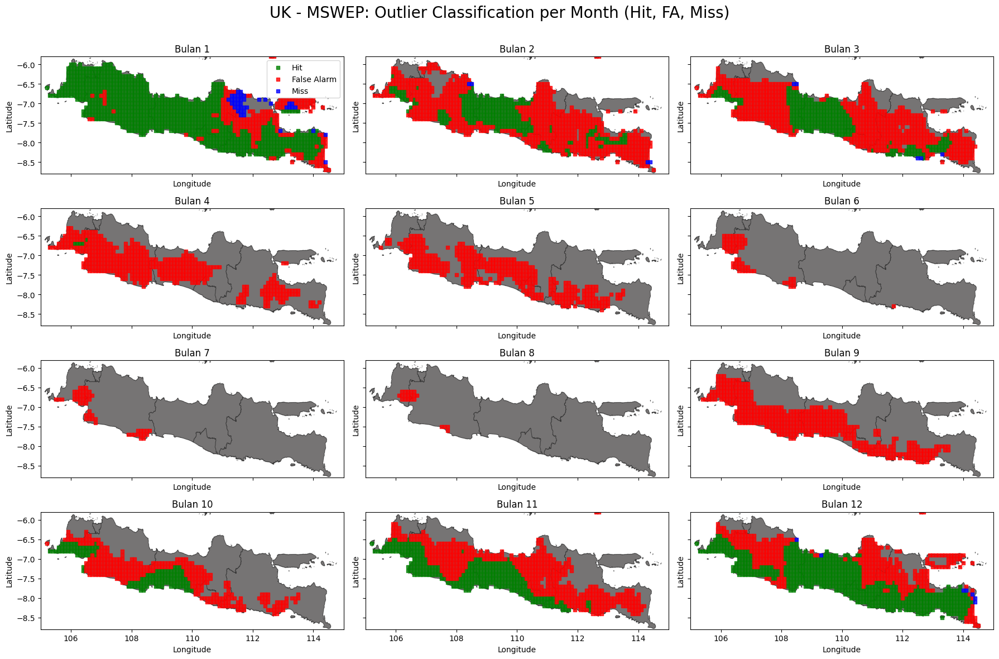

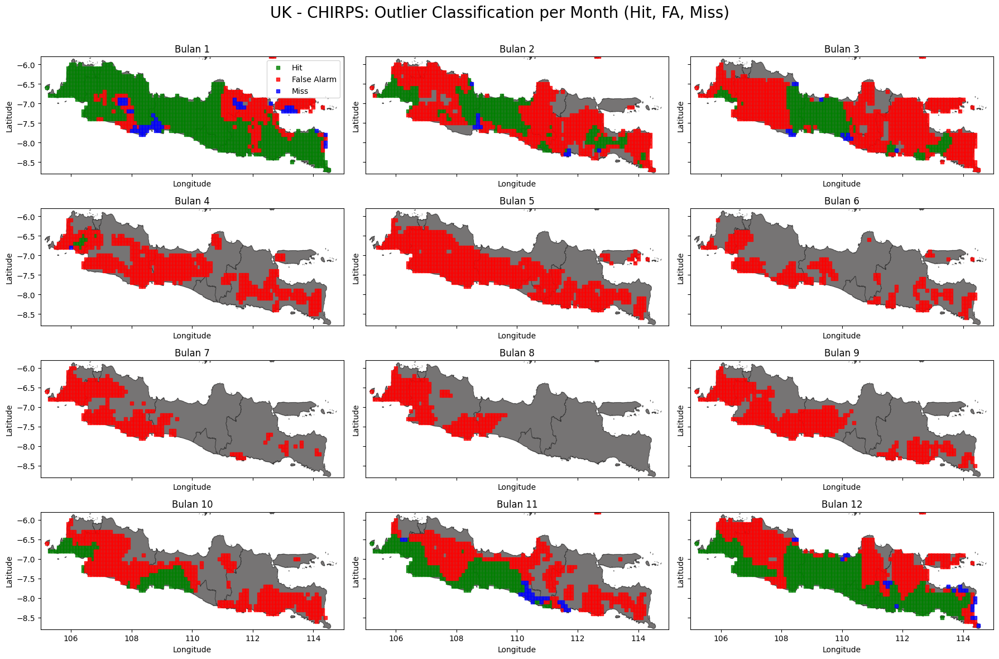

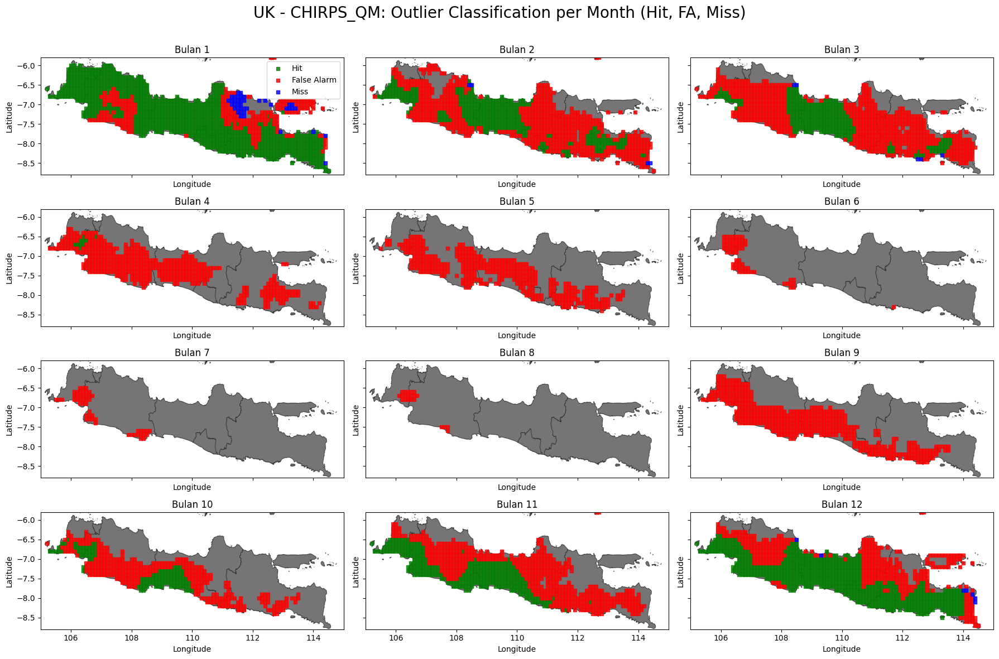

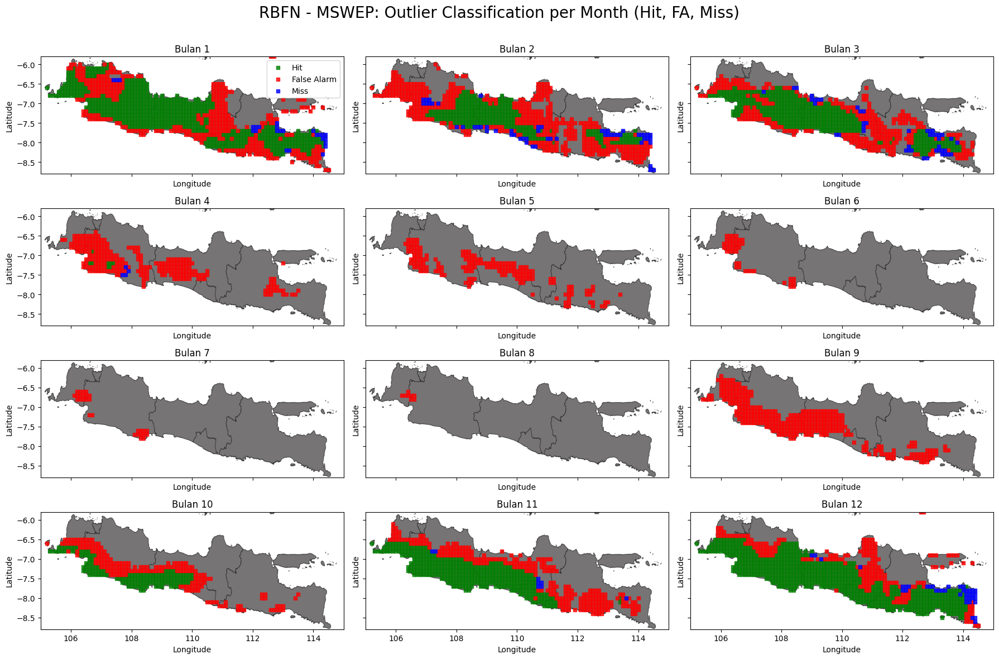

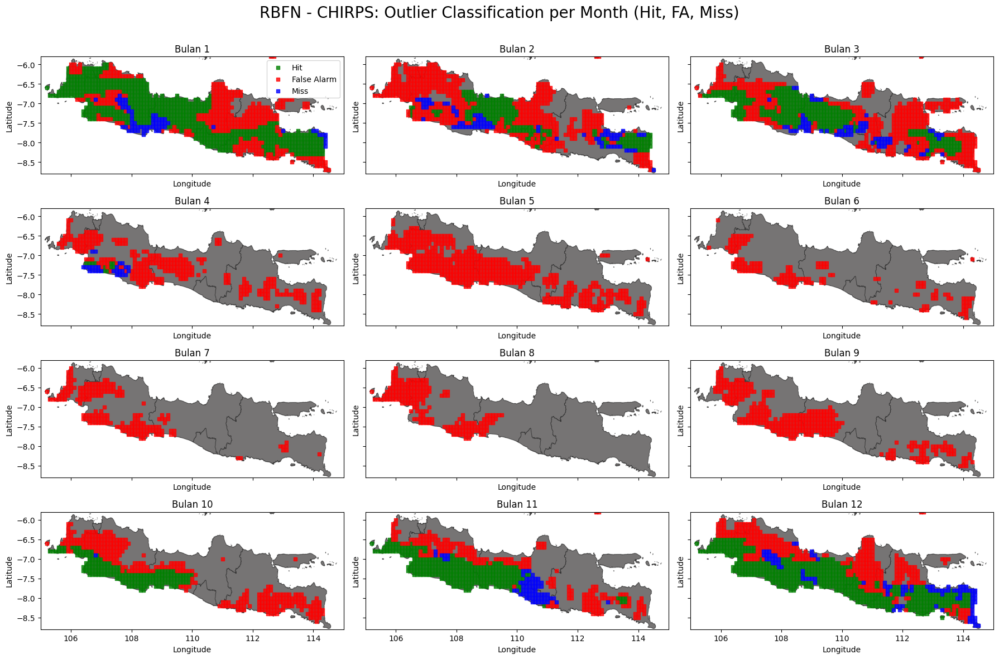

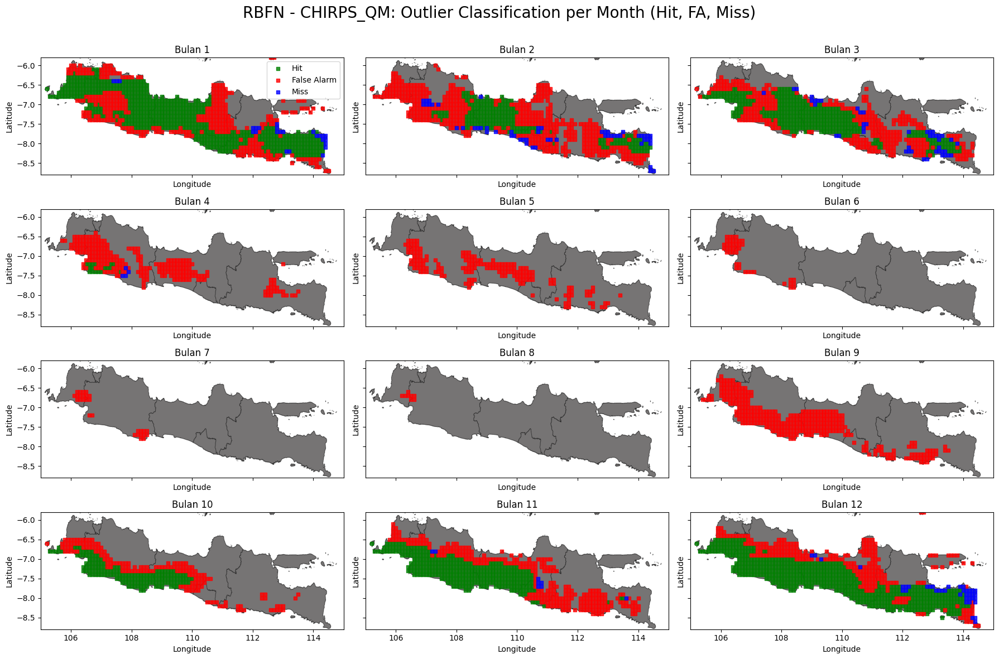

In [219]:
import matplotlib.pyplot as plt
import numpy as np

def filter_priority(hit, fa, miss):
    hit = hit.copy(); hit['type'] = 'hit'
    fa = fa.copy(); fa['type'] = 'fa'
    miss = miss.copy(); miss['type'] = 'miss'
    combined = pd.concat([hit, fa, miss], ignore_index=True)
    priority = {'hit': 0, 'fa': 1, 'miss': 2}
    combined['priority'] = combined['type'].map(priority)
    combined = combined.sort_values(['lon', 'lat', 'priority'])
    filtered = combined.drop_duplicates(subset=['lon', 'lat'], keep='first')
    return filtered

dfs = [df_ok, df_uk, df_rbf]
method_names = ['OK', 'UK', 'RBFN']
perc95s = [
    df_ok['rainfall'].quantile(0.95),
    df_uk['rainfall'].quantile(0.95),
    df_rbf['rainfall'].quantile(0.95)
]
ref_cols = [
    ('pr_mswep', 'MSWEP'),
    ('pr_chirps', 'CHIRPS'),
    ('pr_chirps_qm', 'CHIRPS_QM')
]
months = range(1, 13)

for df, method, perc95 in zip(dfs, method_names, perc95s):
    for ref_col, ref_name in ref_cols:
        fig, axes = plt.subplots(4, 3, figsize=(18, 12), sharex=True, sharey=True)
        axes = axes.flatten()
        for i, month in enumerate(months):
            ax = axes[i]
            d = df[df['month'] == month].copy()
            threshold = perc95
            is_outlier = (d['rainfall'] > threshold) | (d[ref_col] > threshold)
            d = d[is_outlier].copy()
            hit = d[(d['rainfall'] > threshold) & (d[ref_col] > threshold)]
            miss = d[(d['rainfall'] > threshold) & (d[ref_col] <= threshold)]
            fa   = d[(d['rainfall'] <= threshold) & (d[ref_col] > threshold)]
            filtered = filter_priority(hit, fa, miss)
            ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
            if not filtered.empty:
                ax.scatter(filtered[filtered['type'] == 'hit']['lon'], filtered[filtered['type'] == 'hit']['lat'],
                           c='green', marker='s', s=20, label='Hit', alpha=0.8, zorder=2)
                ax.scatter(filtered[filtered['type'] == 'fa']['lon'], filtered[filtered['type'] == 'fa']['lat'],
                           c='red', marker='s', s=20, label='False Alarm', alpha=0.8, zorder=2)
                ax.scatter(filtered[filtered['type'] == 'miss']['lon'], filtered[filtered['type'] == 'miss']['lat'],
                           c='blue', marker='s', s=20, label='Miss', alpha=0.8, zorder=2)
            ax.set_title(f"Bulan {month}")
            ax.set_xlim(minx, maxx)
            ax.set_ylim(miny, maxy)
            ax.set_xlabel('Longitude')
            ax.set_ylabel('Latitude')
            if i == 0:
                ax.legend(loc='upper right', fontsize=10)
        for i in range(len(months), len(axes)):
            axes[i].axis('off')
        fig.suptitle(f'{method} - {ref_name}: Outlier Classification per Month (Hit, FA, Miss)', fontsize=20)
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        #plt.savefig(f'{method}_results/Masked/{method}_Outlier_HitMissFA_Monthly_{ref_name}.png', dpi=300, bbox_inches='tight')
        plt.show()

### Plot

In [134]:
import matplotlib.image as mpimg

# Load the Java map image and define its extent
# REPLACE THESE VALUES WITH YOUR ACTUAL COORDINATES!
jawa_img = mpimg.imread('JAWA.png')
jawa_nodem_img = mpimg.imread('Jawa_nodem.png')
jawa_extent = [minx, maxx, miny, maxy]  # Use same values as your xlim/ylim

#### Rainfall Plot

In [93]:
import numpy as np

years = sorted(df_ok['year'].unique())

for year_to_plot in years:
    df_ok_year = df_ok[df_ok['year'] == year_to_plot]
    df_ok_out = outlier_df_ok[outlier_df_ok['year'] == year_to_plot]

    fig, axes = plt.subplots(4, 3, figsize=(18.5, 12))
    axes = axes.flatten()

    for month in range(1, 13):
        ax = axes[month-1]
        df_month = df_ok_year[df_ok_year['month'] == month]
        df_outliers = df_ok_out[df_ok_out['month'] == month]
        
        if df_month.empty:
            ax.axis('off')
            continue

        # Plot Java map as background image
        #ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
        
        # Scatter plot of rainfall
        sc = ax.scatter(
            df_month['lon'], 
            df_month['lat'], 
            c=df_month['rainfall'],
            cmap='Blues_r', 
            vmin=0, 
            vmax=vmax, 
            zorder=2,
            marker='s',
            s=15.75,
            edgecolors='none',  # No edge color for markers
            #alpha=0.8
        )
        # Plot outliers
        ax.scatter(            
            df_outliers['lon'], 
            df_outliers['lat'], 
            c='none',
            marker='s',
            linewidths=0.5,
            s=15.75, 
            edgecolors='red', 
            label='Outliers', 
            zorder=3
        )
        
        ax.set_title(f'Tahun {year_to_plot} - Bulan {month}')
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)

    # Remove empty subplots
    for i in range(12, len(axes)):
        axes[i].axis('off')

    fig.suptitle(f'Hasil Interpolasi OK Tahun {year_to_plot}', fontsize=20)
    fig.tight_layout(rect=[0, 0.05, 1, 1])
    
    # Add colorbar
    cbar = fig.colorbar(
        sc, 
        ax=axes,
        location='right',
        orientation='vertical', 
        fraction=0.03, 
        pad=0.02, 
        label='Curah Hujan (mm)'
    )
    
    # Save figure
    #fig.savefig(f'OK_results/Masked/OK_Rainfall_Outlier_{year_to_plot}.png', dpi=150, bbox_inches='tight')
    fig.savefig(f'OK_results/Masked/OK_Rainfall_Outlier_{year_to_plot}_noDEM.png', dpi=150, bbox_inches='tight')
    plt.close(fig)  # Close figure to save memory

In [94]:
import matplotlib.image as mpimg
import numpy as np

# Load the Java map image and define its extent
# REPLACE THESE VALUES WITH YOUR ACTUAL COORDINATES!
jawa_img = mpimg.imread('JAWA.png')
jawa_extent = [minx, maxx, miny, maxy]  # Use same values as your xlim/ylim

years = sorted(df_uk['year'].unique())

for year_to_plot in years:
    df_uk_year = df_uk[df_uk['year'] == year_to_plot]
    df_uk_out = outlier_df_uk[outlier_df_uk['year'] == year_to_plot]

    fig, axes = plt.subplots(4, 3, figsize=(18.5, 12))
    axes = axes.flatten()

    for month in range(1, 13):
        ax = axes[month-1]
        df_month = df_uk_year[df_uk_year['month'] == month]
        df_outliers = df_uk_out[df_uk_out['month'] == month]
        
        if df_month.empty:
            ax.axis('off')
            continue

        # Plot Java map as background image
        #ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
        
        # Scatter plot of rainfall
        sc = ax.scatter(
            df_month['lon'], 
            df_month['lat'], 
            c=df_month['rainfall'],
            cmap='Blues_r', 
            vmin=0, 
            vmax=vmax, 
            zorder=2,
            marker='s',
            s=15.75,
            edgecolors='none',  # No edge color for markers
            alpha=0.8
        )
        ax.scatter(            
            df_outliers['lon'], 
            df_outliers['lat'], 
            c='none',
            marker='s',
            linewidths=0.5,
            s=15.75, 
            edgecolors='red', 
            label='Outliers', 
            zorder=3
        )
        
        ax.set_title(f'Tahun {year_to_plot} - Bulan {month}')
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)

    # Remove empty subplots
    for i in range(12, len(axes)):
        axes[i].axis('off')

    fig.suptitle(f'Hasil Interpolasi UK Tahun {year_to_plot}', fontsize=20)
    fig.tight_layout(rect=[0, 0.05, 1, 1])
    
    # Add colorbar
    cbar = fig.colorbar(
        sc, 
        ax=axes,
        location='right',
        orientation='vertical', 
        fraction=0.03, 
        pad=0.02, 
        label='Curah Hujan (mm)'
    )
    
    # Save figure
    #fig.savefig(f'UK_results/Masked/UK_Rainfall_Outlier_{year_to_plot}.png', dpi=150, bbox_inches='tight')
    fig.savefig(f'UK_results/Masked/UK_Rainfall_Outlier_{year_to_plot}_noDEM.png', dpi=150, bbox_inches='tight')
    plt.close(fig)  # Close figure to save memory

In [95]:
import matplotlib.image as mpimg
import numpy as np

# Load the Java map image and define its extent
# REPLACE THESE VALUES WITH YOUR ACTUAL COORDINATES!
jawa_img = mpimg.imread('JAWA.png')
jawa_extent = [minx, maxx, miny, maxy]  # Use same values as your xlim/ylim

years = sorted(df_rbf['year'].unique())

for year_to_plot in years:
    df_rbf_year = df_rbf[df_rbf['year'] == year_to_plot]
    df_rbf_out = outlier_df_rbf[outlier_df_rbf['year'] == year_to_plot]

    fig, axes = plt.subplots(4, 3, figsize=(18.5, 12))
    axes = axes.flatten()

    for month in range(1, 13):
        ax = axes[month-1]
        df_month = df_rbf_year[df_rbf_year['month'] == month]
        df_outliers = df_rbf_out[df_rbf_out['month'] == month]
        
        if df_month.empty:
            ax.axis('off')
            continue

        # Plot Java map as background image
        #ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
        
        # Scatter plot of rainfall
        sc = ax.scatter(
            df_month['lon'], 
            df_month['lat'], 
            c=df_month['rainfall'],
            cmap='Blues_r', 
            vmin=0, 
            vmax=vmax, 
            zorder=2,
            marker='s',
            s=15.75,
            edgecolors='none',  # No edge color for markers
            #alpha=0.8
        )
        ax.scatter(            
            df_outliers['lon'], 
            df_outliers['lat'], 
            c='none',
            marker='s',
            linewidths=0.5,
            s=15.75, 
            edgecolors='red', 
            label='Outliers', 
            zorder=3
        )
        
        ax.set_title(f'Tahun {year_to_plot} - Bulan {month}')
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)

    # Remove empty subplots
    for i in range(12, len(axes)):
        axes[i].axis('off')

    fig.suptitle(f'Hasil Interpolasi OK Tahun {year_to_plot}', fontsize=20)
    fig.tight_layout(rect=[0, 0.05, 1, 1])
    
    # Add colorbar
    cbar = fig.colorbar(
        sc, 
        ax=axes,
        location='right',
        orientation='vertical', 
        fraction=0.03, 
        pad=0.02, 
        label='Curah Hujan (mm)'
    )
    
    # Save figure
    #fig.savefig(f'RBF_results/Masked/RBF_Rainfall_Outlier_{year_to_plot}.png', dpi=150, bbox_inches='tight')
    fig.savefig(f'RBF_results/Masked/RBF_Rainfall_Outlier_{year_to_plot}_noDEM.png', dpi=150, bbox_inches='tight')
    plt.close(fig)  # Close figure to save memory

#### Bias Plotting

In [35]:
import matplotlib.pyplot as plt
import numpy as np

# Pastikan kolom bias sudah ada
# df_ok['bias_mswep'] = df_ok['rainfall'] - df_ok['pr_mswep']
# df_ok['bias_chirps'] = df_ok['rainfall'] - df_ok['pr_chirps']

years = sorted(df_ok['year'].unique())
months = range(1, 13)
bias_cols = ['bias_mswep', 'bias_chirps']
titles = ['Bias MSWEP', 'Bias CHIRPS']

for month in months:
    for year_to_plot in years:
        df_ok_year = df_ok[(df_ok['year'] == year_to_plot) & (df_ok['month'] == month)]
        df_ok_out = outlier_df_ok[(outlier_df_ok['year'] == year_to_plot) & (outlier_df_ok['month'] == month)]

        fig, axes = plt.subplots(2, 1, figsize=(12, 8), sharex=True, sharey=True)
        for i, (bias_col, ax) in enumerate(zip(bias_cols, axes)):
            ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
            sc = ax.scatter(
                df_ok_year['lon'],
                df_ok_year['lat'],
                c=df_ok_year[bias_col],
                cmap='bwr',
                vmin=-300,
                vmax=300,
                marker='s',
                s=50,
                edgecolors='none',
                zorder=2
            )
            ax.scatter(
                df_ok_out['lon'],
                df_ok_out['lat'],
                c='none',
                marker='s',
                linewidths=0.7,
                s=50,
                edgecolors='black',
                zorder=3
            )
            ax.set_title(f"OK: {titles[i]} Tahun {year_to_plot} - Bulan {month}")
            ax.set_xlim(minx, maxx)
            ax.set_ylim(miny, maxy)
            ax.set_xlabel('Longitude')
            ax.set_ylabel('Latitude')
            #ax.legend(loc='upper right', fontsize=8)

        # Place colorbar to the right of the figure using fig.add_axes
        cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
        fig.colorbar(sc, cax=cbar_ax, orientation='vertical', label='Bias (mm)')
        plt.tight_layout(rect=[0, 0, 0.9, 1])
        plt.savefig(f'OK_results/bias_plot/OK_Bias_Outlier_{year_to_plot}_{month}_noDEM.png', dpi=150, bbox_inches='tight')
        #plt.show()
        plt.close(fig)

C:\Users\allam\AppData\Local\Temp\ipykernel_11392\2793101234.py:53: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Pastikan kolom bias sudah ada
# df_ok['bias_mswep'] = df_ok['rainfall'] - df_ok['pr_mswep']
# df_ok['bias_chirps'] = df_ok['rainfall'] - df_ok['pr_chirps']

months = range(1, 13)
years = sorted(df_rbf['year'].unique())
bias_cols = ['bias_mswep', 'bias_chirps']
titles = ['Bias MSWEP', 'Bias CHIRPS']

for month in months:
    for year_to_plot in years:
        df_rbf_year = df_rbf[(df_rbf['year'] == year_to_plot) & (df_rbf['month'] == month)]
        df_rbf_out = outlier_df_rbf[(outlier_df_rbf['year'] == year_to_plot) & (outlier_df_rbf['month'] == month)]

        fig, axes = plt.subplots(2, 1, figsize=(12, 8), sharex=True, sharey=True)
        for i, (bias_col, ax) in enumerate(zip(bias_cols, axes)):
            ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
            sc = ax.scatter(
                df_rbf_year['lon'],
                df_rbf_year['lat'],
                c=df_uk_year[bias_col],
                cmap='bwr',
                vmin=-300,
                vmax=300,
                marker='s',
                s=50,
                edgecolors='none',
                zorder=2
            )
            ax.scatter(
                df_rbf_out['lon'],
                df_rbf_out['lat'],
                c='none',
                marker='s',
                linewidths=0.7,
                s=50,
                edgecolors='black',
                zorder=3
            )
            ax.set_title(f"RBFN: {titles[i]} Tahun {year_to_plot} - Bulan {month}")
            ax.set_xlim(minx, maxx)
            ax.set_ylim(miny, maxy)
            ax.set_xlabel('Longitude')
            ax.set_ylabel('Latitude')
            #ax.legend(loc='upper right', fontsize=8)

        # Place colorbar to the right of the figure using fig.add_axes
        cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
        fig.colorbar(sc, cax=cbar_ax, orientation='vertical', label='Bias (mm)')
        plt.tight_layout(rect=[0, 0, 0.9, 1])
        plt.savefig(f'RBF_results/bias_plot/RBF_Bias_Outlier_{year_to_plot}_{month}_noDEM.png', dpi=150, bbox_inches='tight')
        #plt.show()
        plt.close(fig)

C:\Users\allam\AppData\Local\Temp\ipykernel_11392\3099077783.py:53: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


#### Outlier Plot

##### Monthly

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\1141581431.py:51: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


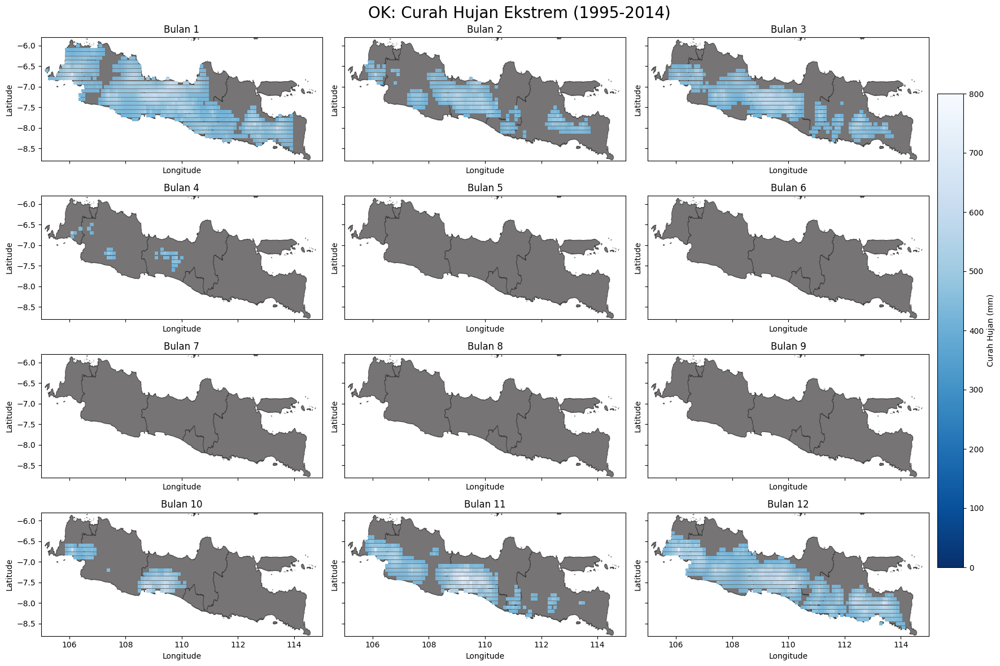

In [135]:
import matplotlib.pyplot as plt
import numpy as np

# Plot outlier rainfall: 1 figure, 12 subplot (1 subplot = 1 bulan, seluruh tahun)
months = range(1, 13)

fig, axes = plt.subplots(4, 3, figsize=(18.5, 12), sharex=True, sharey=True)
axes = axes.flatten()

for i, month in enumerate(months):
    ax = axes[i]
    ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
    # Ambil semua outlier untuk bulan ini di seluruh tahun
    df_ok_out = outlier_df_ok[outlier_df_ok['month'] == month]
    # Jika ada titik duplikat (lon, lat), ambil rainfall tertinggi (dari semua tahun)
    if not df_ok_out.empty:
        df_ok_out = df_ok_out.sort_values('rainfall', ascending=False)
        df_ok_out = df_ok_out.drop_duplicates(subset=['lon', 'lat'], keep='first')
        sc = ax.scatter(
            df_ok_out['lon'],
            df_ok_out['lat'],
            c=df_ok_out['rainfall'],
            cmap='Blues_r',
            marker='s',
            linewidths=0.7,
            s=20,
            edgecolors='none',
            zorder=3,
            vmin=0,
            vmax=vmax
        )
    else:
        sc = None
    ax.set_title(f"Bulan {month}")
    ax.set_xlim(minx, maxx)
    ax.set_ylim(miny, maxy)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

# Kosongkan subplot jika data < 12
for i in range(len(months), len(axes)):
    axes[i].axis('off')

fig.suptitle('OK: Curah Hujan Ekstrem (1995-2014)', fontsize=20)

# Tambahkan colorbar hanya jika ada data
if sc is not None:
    cbar = fig.add_axes([0.9, 0.15, 0.025, 0.7])
    fig.colorbar(sc, cax=cbar, orientation='vertical', fraction=0.03, pad=0.02, label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.savefig('OK_results/Masked/OK_Outlier_Rainfall_noDEM.png', dpi=300, bbox_inches='tight')
plt.show()
#plt.close(fig)

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\4032440098.py:51: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


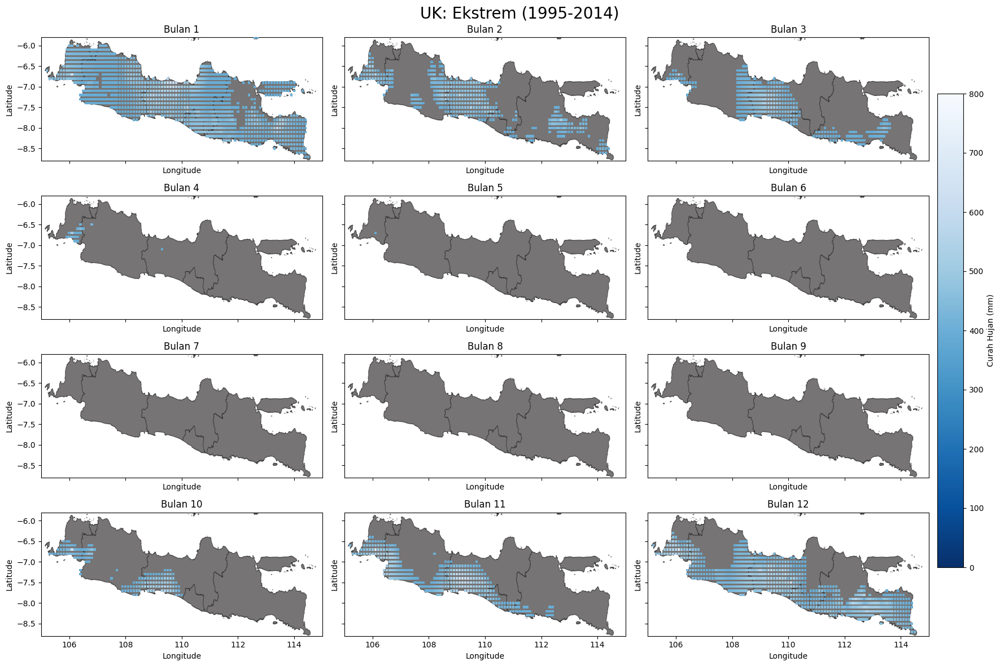

In [136]:
import matplotlib.pyplot as plt
import numpy as np

# Plot outlier rainfall: 1 figure, 12 subplot (1 subplot = 1 bulan, seluruh tahun)
months = range(1, 13)

fig, axes = plt.subplots(4, 3, figsize=(18.5, 12), sharex=True, sharey=True)
axes = axes.flatten()

for i, month in enumerate(months):
    ax = axes[i]
    ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
    # Ambil semua outlier untuk bulan ini di seluruh tahun
    df_uk_out = outlier_df_uk[outlier_df_uk['month'] == month]
    # Jika ada titik duplikat (lon, lat), ambil rainfall tertinggi (dari semua tahun)
    if not df_uk_out.empty:
        df_uk_out = df_uk_out.sort_values('rainfall', ascending=False)
        df_uk_out = df_uk_out.drop_duplicates(subset=['lon', 'lat'], keep='first')
        sc = ax.scatter(
            df_uk_out['lon'],
            df_uk_out['lat'],
            c=df_uk_out['rainfall'],
            cmap='Blues_r',
            marker='s',
            linewidths=0.7,
            s=10,
            edgecolors='none',
            zorder=3,
            vmin=0,
            vmax=vmax
        )
    else:
        sc = None
    ax.set_title(f"Bulan {month}")
    ax.set_xlim(minx, maxx)
    ax.set_ylim(miny, maxy)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

# Kosongkan subplot jika data < 12
for i in range(len(months), len(axes)):
    axes[i].axis('off')

fig.suptitle('UK: Ekstrem (1995-2014)', fontsize=20)

# Tambahkan colorbar hanya jika ada data
if sc is not None:
    cbar = fig.add_axes([0.9, 0.15, 0.025, 0.7])
    fig.colorbar(sc, cax=cbar, orientation='vertical', fraction=0.03, pad=0.02, label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.savefig('UK_results/Masked/UK_Outlier_Rainfall_noDEM.png', dpi=300, bbox_inches='tight')
plt.show()
#plt.close(fig)

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\1803741870.py:52: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


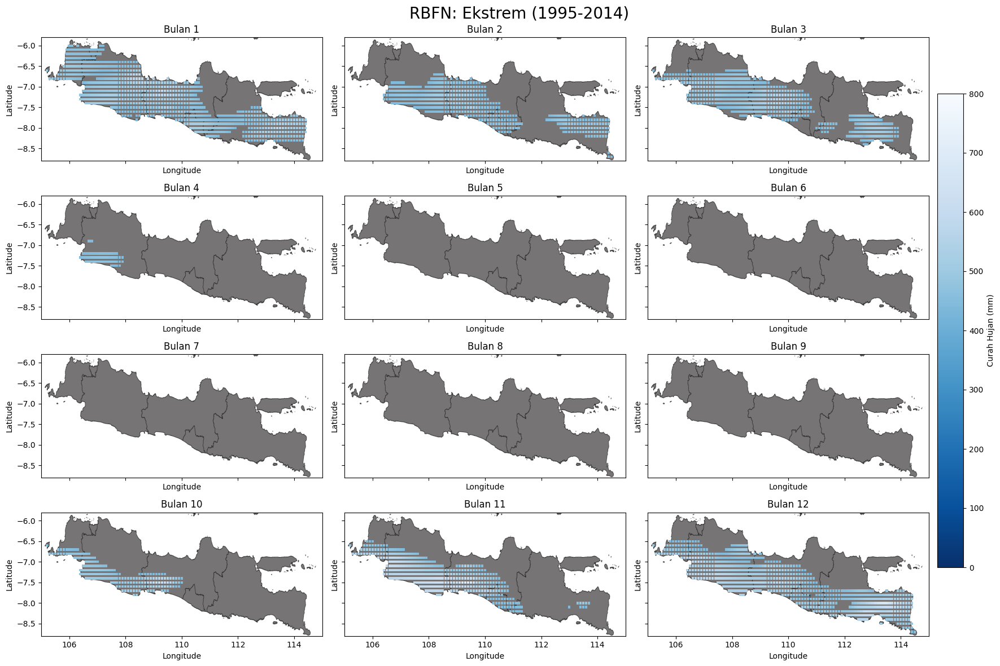

In [137]:
import matplotlib.pyplot as plt
import numpy as np

# Plot outlier rainfall: 1 figure, 12 subplot (1 subplot = 1 bulan, seluruh tahun)
months = range(1, 13)

fig, axes = plt.subplots(4, 3, figsize=(18.5, 12), sharex=True, sharey=True)
axes = axes.flatten()

for i, month in enumerate(months):
    ax = axes[i]
    ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
    # Ambil semua outlier untuk bulan ini di seluruh tahun
    df_rbf_out = outlier_df_rbf[outlier_df_rbf['month'] == month]
    # Jika ada titik duplikat (lon, lat), ambil rainfall tertinggi (dari semua tahun)
    if not df_rbf_out.empty:
        df_rbf_out = df_rbf_out.sort_values('rainfall', ascending=False)
        df_rbf_out = df_rbf_out.drop_duplicates(subset=['lon', 'lat'], keep='first')
        sc = ax.scatter(
            df_rbf_out['lon'],
            df_rbf_out['lat'],
            c=df_rbf_out['rainfall'],
            cmap='Blues_r',
            marker='s',
            linewidths=0.7,
            s=10,
            edgecolors='none',
            zorder=3,
            #alpha=0.8
            vmin=0,
            vmax=vmax
        )
    else:
        sc = None
    ax.set_title(f"Bulan {month}")
    ax.set_xlim(minx, maxx)
    ax.set_ylim(miny, maxy)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

# Kosongkan subplot jika data < 12
for i in range(len(months), len(axes)):
    axes[i].axis('off')

fig.suptitle('RBFN: Ekstrem (1995-2014)', fontsize=20)

# Tambahkan colorbar hanya jika ada data
if sc is not None:
    cbar = fig.add_axes([0.9, 0.15, 0.025, 0.7])
    fig.colorbar(sc, cax=cbar, orientation='vertical', fraction=0.03, pad=0.02, label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.savefig('RBFN_results/Masked/RBFN_Outlier_Rainfall_noDEM.png', dpi=300, bbox_inches='tight')
plt.show()
#plt.close(fig)

##### Seasonal

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2970750673.py:61: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


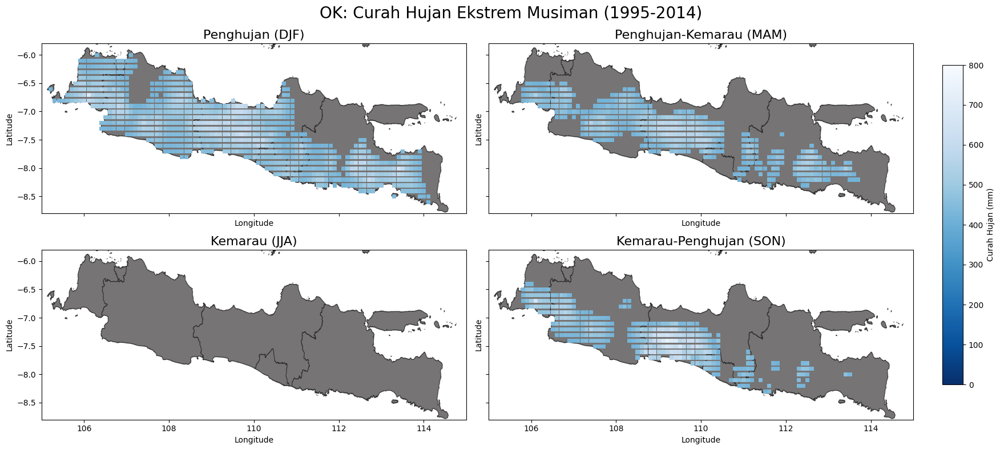

<Figure size 640x480 with 0 Axes>

In [192]:
import matplotlib.pyplot as plt
import numpy as np

# Definisikan bulan untuk setiap musim
DJF = [12, 1, 2]
MAM = [3, 4, 5]
JJA = [6, 7, 8]
SON = [9, 10, 11]
seasons = {
    'Penghujan (DJF)': DJF,
    'Penghujan-Kemarau (MAM)': MAM,
    'Kemarau (JJA)': JJA,
    'Kemarau-Penghujan (SON)': SON
}

# Siapkan data outlier untuk setiap musim
seasonal_outliers = {}
for season, months in seasons.items():
    # Untuk DJF, bulan 12 harus diambil dari tahun sebelumnya juga
    df_season = outlier_df_ok[outlier_df_ok['month'].isin(months)]
    # Pilih rainfall tertinggi jika ada duplikat lon/lat
    df_season = df_season.sort_values('rainfall', ascending=False)
    df_season = df_season.drop_duplicates(subset=['lon', 'lat'], keep='first')
    seasonal_outliers[season] = df_season

fig, axes = plt.subplots(2, 2, figsize=(18, 8), sharex=True, sharey=True)
axes = axes.flatten()

for i, (season, df_season) in enumerate(seasonal_outliers.items()):
    ax = axes[i]
    ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
    sc = ax.scatter(
        df_season['lon'],
        df_season['lat'],
        c=df_season['rainfall'],
        cmap='Blues_r',
        marker='s',
        linewidths=0.7,
        s=20,
        #edgecolors='black',
        zorder=3,
        vmin=0,
        vmax=vmax
    )
    ax.set_title(season, fontsize=16)
    ax.set_xlim(minx, maxx)
    ax.set_ylim(miny, maxy)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

# Kosongkan subplot jika kurang dari 4
for i in range(len(seasons), len(axes)):
    axes[i].axis('off')

fig.suptitle('OK: Curah Hujan Ekstrem Musiman (1995-2014)', fontsize=20)

# Tambahkan colorbar di kanan
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
fig.colorbar(sc, cax=cbar_ax, orientation='vertical', label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.show()
plt.savefig('OK_results/bias_plot/OK_Outlier_Rainfall_Seasonal_noDEM.png', dpi=150, bbox_inches='tight')
#plt.close(fig)

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\3477642958.py:61: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


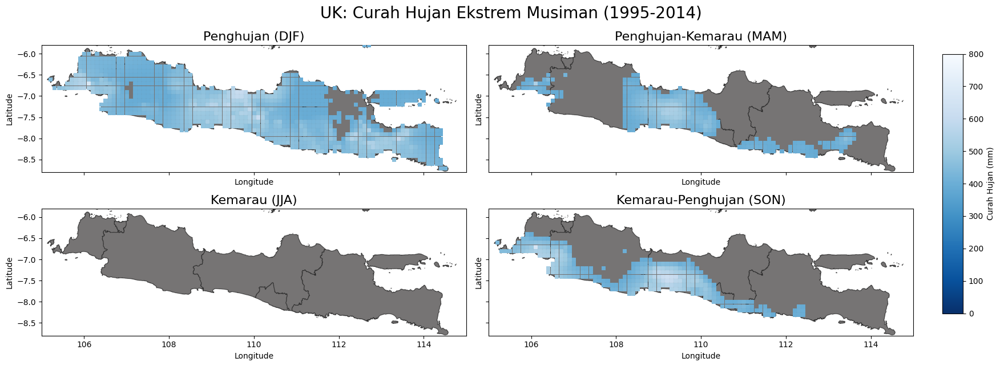

<Figure size 640x480 with 0 Axes>

In [139]:
import matplotlib.pyplot as plt
import numpy as np

# Definisikan bulan untuk setiap musim
DJF = [12, 1, 2]
MAM = [3, 4, 5]
JJA = [6, 7, 8]
SON = [9, 10, 11]
seasons = {
    'Penghujan (DJF)': DJF,
    'Penghujan-Kemarau (MAM)': MAM,
    'Kemarau (JJA)': JJA,
    'Kemarau-Penghujan (SON)': SON
}

# Siapkan data outlier untuk setiap musim
seasonal_outliers = {}
for season, months in seasons.items():
    # Untuk DJF, bulan 12 harus diambil dari tahun sebelumnya juga
    df_season = outlier_df_uk[outlier_df_uk['month'].isin(months)]
    # Pilih rainfall tertinggi jika ada duplikat lon/lat
    df_season = df_season.sort_values('rainfall', ascending=False)
    df_season = df_season.drop_duplicates(subset=['lon', 'lat'], keep='first')
    seasonal_outliers[season] = df_season

fig, axes = plt.subplots(2, 2, figsize=(18, 6.5), sharex=True, sharey=True)
axes = axes.flatten()

for i, (season, df_season) in enumerate(seasonal_outliers.items()):
    ax = axes[i]
    ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
    sc = ax.scatter(
        df_season['lon'],
        df_season['lat'],
        c=df_season['rainfall'],
        cmap='Blues_r',
        marker='s',
        linewidths=0.7,
        s=20,
        #edgecolors='black',
        zorder=3,
        vmin=0,
        vmax=vmax
    )
    ax.set_title(season, fontsize=16)
    ax.set_xlim(minx, maxx)
    ax.set_ylim(miny, maxy)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

# Kosongkan subplot jika kurang dari 4
for i in range(len(seasons), len(axes)):
    axes[i].axis('off')

fig.suptitle('UK: Curah Hujan Ekstrem Musiman (1995-2014)', fontsize=20)

# Tambahkan colorbar di kanan
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
fig.colorbar(sc, cax=cbar_ax, orientation='vertical', label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.show()
plt.savefig('UK_results/bias_plot/UK_Outlier_Rainfall_Seasonal_noDEM.png', dpi=150, bbox_inches='tight')
#plt.close(fig)

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\3534213864.py:61: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


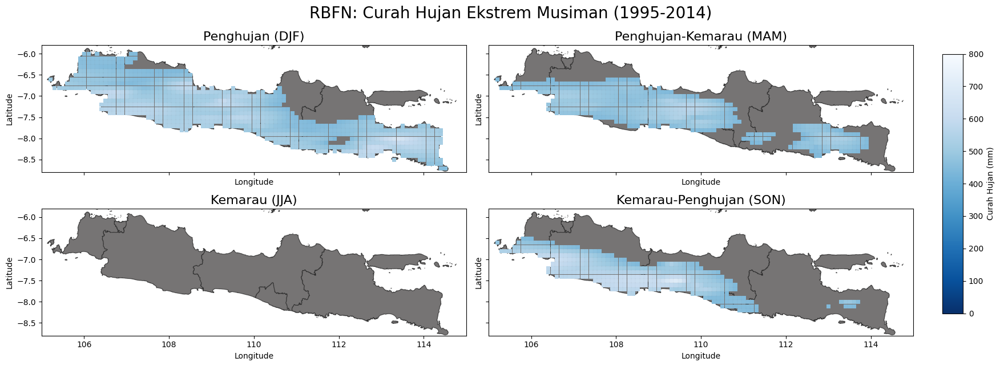

<Figure size 640x480 with 0 Axes>

In [140]:
import matplotlib.pyplot as plt
import numpy as np

# Definisikan bulan untuk setiap musim
DJF = [12, 1, 2]
MAM = [3, 4, 5]
JJA = [6, 7, 8]
SON = [9, 10, 11]
seasons = {
    'Penghujan (DJF)': DJF,
    'Penghujan-Kemarau (MAM)': MAM,
    'Kemarau (JJA)': JJA,
    'Kemarau-Penghujan (SON)': SON
}

# Siapkan data outlier untuk setiap musim
seasonal_outliers = {}
for season, months in seasons.items():
    # Untuk DJF, bulan 12 harus diambil dari tahun sebelumnya juga
    df_season = outlier_df_rbf[outlier_df_rbf['month'].isin(months)]
    # Pilih rainfall tertinggi jika ada duplikat lon/lat
    df_season = df_season.sort_values('rainfall', ascending=False)
    df_season = df_season.drop_duplicates(subset=['lon', 'lat'], keep='first')
    seasonal_outliers[season] = df_season

fig, axes = plt.subplots(2, 2, figsize=(18, 6.5), sharex=True, sharey=True)
axes = axes.flatten()

for i, (season, df_season) in enumerate(seasonal_outliers.items()):
    ax = axes[i]
    ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')
    sc = ax.scatter(
        df_season['lon'],
        df_season['lat'],
        c=df_season['rainfall'],
        cmap='Blues_r',
        marker='s',
        linewidths=0.7,
        s=20,
        #edgecolors='black',
        zorder=3,
        vmin=0,
        vmax=vmax
    )
    ax.set_title(season, fontsize=16)
    ax.set_xlim(minx, maxx)
    ax.set_ylim(miny, maxy)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

# Kosongkan subplot jika kurang dari 4
for i in range(len(seasons), len(axes)):
    axes[i].axis('off')

fig.suptitle('RBFN: Curah Hujan Ekstrem Musiman (1995-2014)', fontsize=20)

# Tambahkan colorbar di kanan
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
fig.colorbar(sc, cax=cbar_ax, orientation='vertical', label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.show()
plt.savefig('RBFN_results/bias_plot/RBFN_Outlier_Rainfall_Seasonal_noDEM.png', dpi=150, bbox_inches='tight')
#plt.close(fig)

##### All Year

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\1517479611.py:40: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


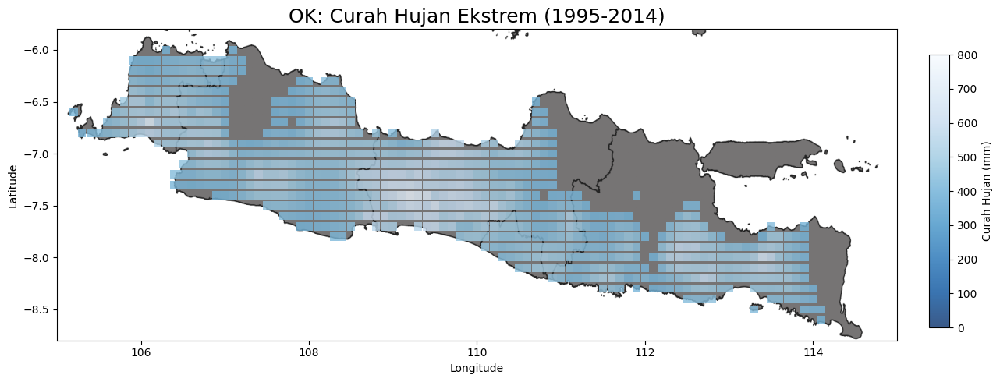

In [141]:
import matplotlib.pyplot as plt
import numpy as np

# Gabungkan seluruh outlier dari semua bulan dan tahun
# Jika ada titik duplikat (lon, lat), ambil rainfall tertinggi (dari semua tahun dan bulan)
df_ok_out = outlier_df_ok.sort_values('rainfall', ascending=False)
df_ok_out = df_ok_out.drop_duplicates(subset=['lon', 'lat'], keep='first')

fig, ax = plt.subplots(figsize=(13, 5))

# Plot background peta Jawa
ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')

# Plot semua outlier
sc = ax.scatter(
    df_ok_out['lon'],
    df_ok_out['lat'],
    c=df_ok_out['rainfall'],
    cmap='Blues_r',
    marker='s',
    linewidths=0.7,
    s=57.5,
    edgecolors='none',
    #zorder=3
    alpha=0.8,
    vmin=0,
    vmax=vmax
)

ax.set_title('OK: Curah Hujan Ekstrem (1995-2014)', fontsize=18)
ax.set_xlim(minx, maxx)
ax.set_ylim(miny, maxy)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Tambahkan colorbar di kanan
cbar = fig.add_axes([0.92, 0.15, 0.02, 0.7])
fig.colorbar(sc, cax=cbar, orientation='vertical', label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.savefig('OK_results/Masked/OK_Outlier_allyears.png', dpi=300, bbox_inches='tight')
plt.show()
#plt.close(fig)

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\686642678.py:40: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


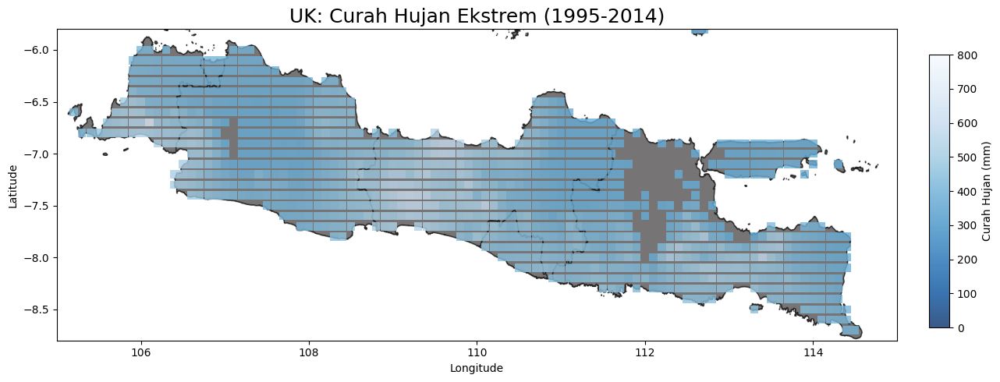

In [142]:
import matplotlib.pyplot as plt
import numpy as np

# Gabungkan seluruh outlier dari semua bulan dan tahun
# Jika ada titik duplikat (lon, lat), ambil rainfall tertinggi (dari semua tahun dan bulan)
df_uk_out = outlier_df_uk.sort_values('rainfall', ascending=False)
df_uk_out = df_uk_out.drop_duplicates(subset=['lon', 'lat'], keep='first')

fig, ax = plt.subplots(figsize=(13, 5))

# Plot background peta Jawa
ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')

# Plot semua outlier
sc = ax.scatter(
    df_uk_out['lon'],
    df_uk_out['lat'],
    c=df_uk_out['rainfall'],
    cmap='Blues_r',
    marker='s',
    linewidths=0.7,
    s=57.5,
    edgecolors='none',
    #zorder=3
    alpha=0.8,
    vmin=0,
    vmax=vmax
)

ax.set_title('UK: Curah Hujan Ekstrem (1995-2014)', fontsize=18)
ax.set_xlim(minx, maxx)
ax.set_ylim(miny, maxy)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Tambahkan colorbar di kanan
cbar = fig.add_axes([0.92, 0.15, 0.02, 0.7])
fig.colorbar(sc, cax=cbar, orientation='vertical', label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.savefig('UK_results/Masked/UK_Outlier_allyears.png', dpi=300, bbox_inches='tight')
plt.show()
#plt.close(fig)

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\297647087.py:40: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


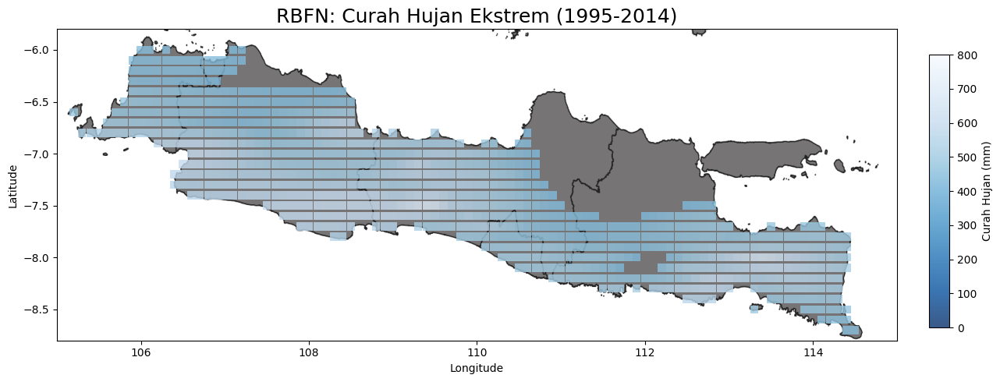

In [143]:
import matplotlib.pyplot as plt
import numpy as np

# Gabungkan seluruh outlier dari semua bulan dan tahun
# Jika ada titik duplikat (lon, lat), ambil rainfall tertinggi (dari semua tahun dan bulan)
df_rbf_out = outlier_df_rbf.sort_values('rainfall', ascending=False)
df_rbf_out = df_rbf_out.drop_duplicates(subset=['lon', 'lat'], keep='first')

fig, ax = plt.subplots(figsize=(13, 5))

# Plot background peta Jawa
ax.imshow(jawa_nodem_img, extent=jawa_extent, zorder=1, aspect='auto')

# Plot semua outlier
sc = ax.scatter(
    df_rbf_out['lon'],
    df_rbf_out['lat'],
    c=df_rbf_out['rainfall'],
    cmap='Blues_r',
    marker='s',
    linewidths=0.7,
    s=57.5,
    edgecolors='none',
    #zorder=3
    alpha=0.8,
    vmin=0,
    vmax=vmax
)

ax.set_title('RBFN: Curah Hujan Ekstrem (1995-2014)', fontsize=18)
ax.set_xlim(minx, maxx)
ax.set_ylim(miny, maxy)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Tambahkan colorbar di kanan
cbar = fig.add_axes([0.92, 0.15, 0.02, 0.7])
fig.colorbar(sc, cax=cbar, orientation='vertical', label='Curah Hujan (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.savefig('RBFN_results/Masked/RBFN_Outlier_allyears.png', dpi=300, bbox_inches='tight')
plt.show()
#plt.close(fig)

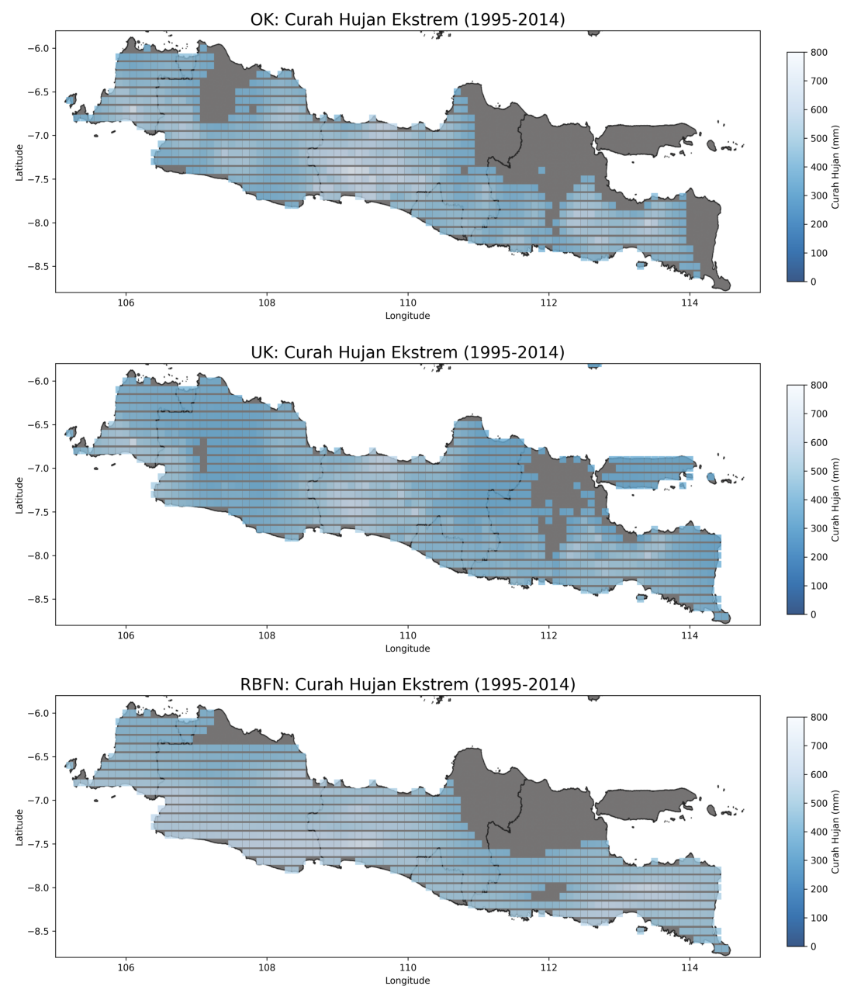

In [144]:
img_ok = mpimg.imread('OK_results/Masked/OK_Outlier_allyears.png')
img_uk = mpimg.imread('UK_results/Masked/UK_Outlier_allyears.png')
img_rbf = mpimg.imread('RBFN_results/Masked/RBFN_Outlier_allyears.png')

fig, axes = plt.subplots(3, 1, figsize=(21, 13))

axes[0].imshow(img_ok)
axes[0].axis('off')

axes[1].imshow(img_uk)
axes[1].axis('off')

axes[2].imshow(img_rbf)
axes[2].axis('off')

plt.tight_layout()

# Add labels below each subplot using fig.text
#fig.text(0.5, 0.51, '(a)', ha='center', va='top', fontsize=16)
#fig.text(0.5, 0.02, '(b)', ha='center', va='top', fontsize=16)

#### Eval

In [145]:
eval = pd.read_excel('eval.xlsx', sheet_name='Sheet1')
eval

,Evaluasi,OK,UK,RBFN
0,RMSE MSWEP,65.34,68.14,68.42
1,RMSE CHIRPS,97.16,99.18,98.34
2,MAE MSWEP,50.79,53.59,53.59
3,MAE CHIRPS,71.54,73.11,73.35
4,SP MSWEP,0.68,0.64,0.65
5,SP CHIRPS,0.59,0.56,0.57


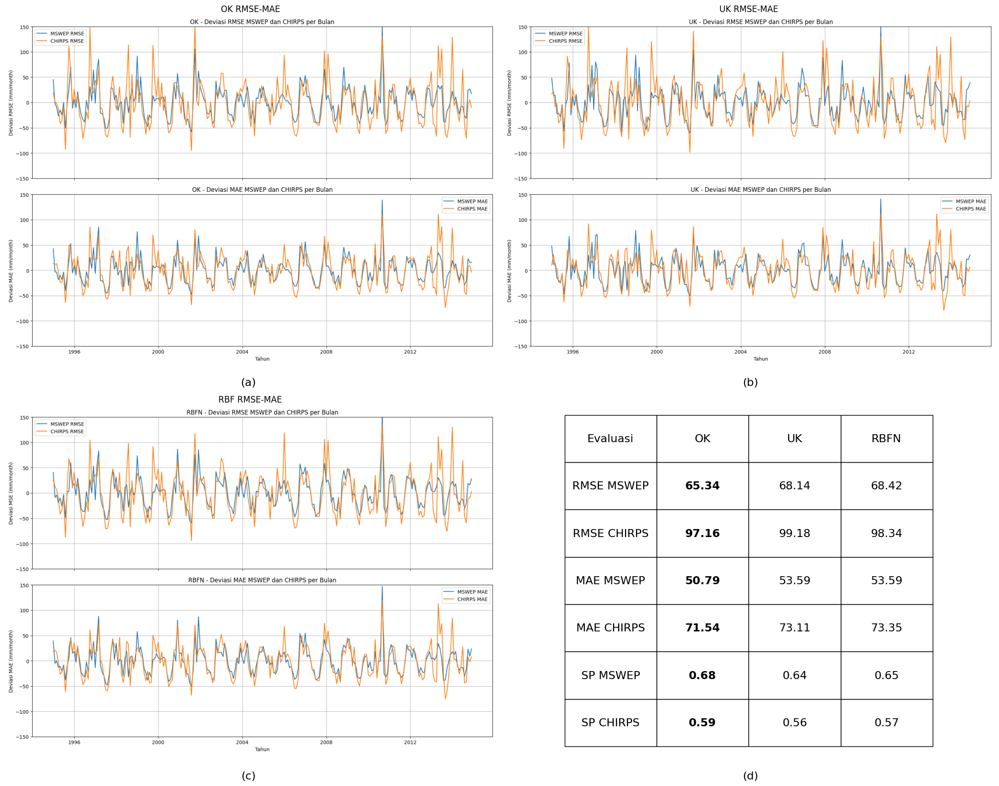

In [146]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img1 = mpimg.imread('OK_rmse-mae.png')
img2 = mpimg.imread('UK_rmse-mae.png')
img3 = mpimg.imread('RBF_rmse-mae.png')

fig, axes = plt.subplots(2, 2, figsize=(20, 16))
axes = axes.flatten()

axes[0].imshow(img1)
axes[0].set_title('OK RMSE-MAE')
axes[0].axis('off')

axes[1].imshow(img2)
axes[1].set_title('UK RMSE-MAE')
axes[1].axis('off')

axes[2].imshow(img3)
axes[2].set_title('RBF RMSE-MAE')
axes[2].axis('off')

# Add table to axes[3]
axes[3].axis('off')
table = axes[3].table(
    cellText=eval.values,
    colLabels=eval.columns,
    loc='center',
    cellLoc='center'
)
table.auto_set_font_size(False)
table.set_fontsize(16)
table.scale(0.75, 4)

row_labels = eval.iloc[:, 0].values  # Assuming first column contains row labels

# Define which rows to bold min or max
min_rows = ['RMSE MSWEP', 'RMSE CHIRPS', 'MAE MSWEP', 'MAE CHIRPS']
max_rows = ['SP MSWEP', 'SP CHIRPS']

for i, label in enumerate(row_labels):
    # Data columns (skip first column if it's label)
    data = eval.iloc[i, 1:].values.astype(float)
    if label in min_rows:
        idx = data.argmin() + 1  # +1 because col 0 is label
    elif label in max_rows:
        idx = data.argmax() + 1
    else:
        continue
    # Set fontweight bold for the cell
    cell = table[(i + 1, idx)]  # +1 because row 0 is header
    if cell.get_text() is not None:
        cell.get_text().set_fontweight('bold')

fig.text(0.25, 0.51, '(a)', ha='center', va='top', fontsize=16)
fig.text(0.75, 0.51, '(b)', ha='center', va='top', fontsize=16)
fig.text(0.25, 0.02, '(c)', ha='center', va='top', fontsize=16)
fig.text(0.75, 0.02, '(d)', ha='center', va='top', fontsize=16)

plt.tight_layout()
plt.show()

##### Metrics

In [147]:
metrics_ok = pd.read_csv('OK_results/Combined_OK_Metrics_1995_2014-Exponential.csv')
metrics_uk = pd.read_csv('UK_results/Combined_UK_Metrics_1995_2014.csv')
metrics_rbf = pd.read_csv('RBFN_results/Combined_RBFN_Metrics_1995_2014.csv')

metrics_ok = metrics_ok.drop(columns={'Unnamed: 0'}, errors='ignore')
metrics_uk = metrics_uk.drop(columns={'Unnamed: 0'}, errors='ignore')
metrics_rbf = metrics_rbf.drop(columns={'Unnamed: 0'}, errors='ignore')

In [220]:
# Simplified metrics calculation and DataFrame creation

metrics_dict = {
    'OK': metrics_ok,
    'UK': metrics_uk,
    'RBFN': metrics_rbf
}

metrics_names = [
    ('rmse_mswep', 'RMSE MSWEP'),
    ('rmse_chirps_qm', 'RMSE CHIRPS (Corrected)'),
    ('mae_mswep', 'MAE MSWEP'),
    ('mae_chirps_qm', 'MAE CHIRPS (Corrected)'),
    ('spearman_mswep', 'SP MSWEP'),
    ('spearman_chirps_qm', 'SP CHIRPS (Corrected)')
]

data = {'Metrics': [name for _, name in metrics_names]}
for key, df in metrics_dict.items():
    data[key] = [df[col].mean().round(2) for col, _ in metrics_names]

eval = pd.DataFrame(data)
eval.to_csv('eval_all_method.csv')

In [149]:
test_ok = pd.read_csv("OK_results/OK_CV_Metrics_1995_2014.csv")
test_uk = pd.read_csv("UK_results/UK_CV_Metrics_1995_2014.csv")
test_rbf = pd.read_csv("RBFN_results/RBFI_CV_Metrics_1995_2014.csv")
test_ex = pd.read_csv("OK_results/OK_CV_Metrics_1995_2014-Exponential.csv")

In [150]:
rmse_ok = test_ok['rmse'].mean()
rmse_uk = test_uk['rmse'].mean()
rmse_rbf = test_rbf['rmse'].mean()
rmse_ex = test_ex['rmse'].mean()

mswep_rmse_ok = eval.loc[eval['Metrics'] == 'RMSE MSWEP', 'OK'].values[0]
chirps_rmse_ok = eval.loc[eval['Metrics'] == 'RMSE CHIRPS (Corrected)', 'OK'].values[0]
mswep_rmse_uk = eval.loc[eval['Metrics'] == 'RMSE MSWEP', 'UK'].values[0]
chirps_rmse_uk = eval.loc[eval['Metrics'] == 'RMSE CHIRPS (Corrected)', 'UK'].values[0]
mswep_rmse_rbf = eval.loc[eval['Metrics'] == 'RMSE MSWEP', 'RBFN'].values[0]
chirps_rmse_rbf = eval.loc[eval['Metrics'] == 'RMSE CHIRPS (Corrected)', 'RBFN'].values[0]
mswep_rmse_ex = eval.loc[eval['Metrics'] == 'RMSE MSWEP', 'OK'].values[0]
chirps_rmse_ex = eval.loc[eval['Metrics'] == 'RMSE CHIRPS (Corrected)', 'OK'].values[0]

print(f"OK MSWEP   - CV: {rmse_ok:.2f} vs Model: {mswep_rmse_ok:.2f}")
print(f"OK CHIRPS  - CV: {rmse_ok:.2f} vs Model: {chirps_rmse_ok:.2f}")
print(f"OK (Ex) MSWEP   - CV: {rmse_ex:.2f} vs Model: {mswep_rmse_ex:.2f}")
print(f"OK (Ex) CHIRPS  - CV: {rmse_ex:.2f} vs Model: {chirps_rmse_ex:.2f}")
print(f"UK MSWEP   - CV: {rmse_uk:.2f} vs Model: {mswep_rmse_uk:.2f}")
print(f"UK CHIRPS  - CV: {rmse_uk:.2f} vs Model: {chirps_rmse_uk:.2f}")
print(f"RBF MSWEP  - CV: {rmse_rbf:.2f} vs Model: {mswep_rmse_rbf:.2f}")
print(f"RBF CHIRPS - CV: {rmse_rbf:.2f} vs Model: {chirps_rmse_rbf:.2f}")

OK MSWEP   - CV: 49.31 vs Model: 64.95
OK CHIRPS  - CV: 49.31 vs Model: 66.18
OK (Ex) MSWEP   - CV: 50.21 vs Model: 64.95
OK (Ex) CHIRPS  - CV: 50.21 vs Model: 66.18
UK MSWEP   - CV: 48.33 vs Model: 68.14
UK CHIRPS  - CV: 48.33 vs Model: 69.26
RBF MSWEP  - CV: 51.81 vs Model: 68.42
RBF CHIRPS - CV: 51.81 vs Model: 69.30


### All Year Plot

In [171]:
df_ok = df_ok.drop(columns=['GID_1', 'GID_0', 'COUNTRY', 'NAME_1', 'VARNAME_1', 'NL_NAME_1', 'TYPE_1', 'ENGTYPE_1', 'CC_1', 'HASC_1', 'ISO_1'], errors='ignore')
df_uk = df_uk.drop(columns=['GID_1', 'GID_0', 'COUNTRY', 'NAME_1', 'VARNAME_1', 'NL_NAME_1', 'TYPE_1', 'ENGTYPE_1', 'CC_1', 'HASC_1', 'ISO_1'], errors='ignore')
df_rbf = df_rbf.drop(columns=['GID_1', 'GID_0', 'COUNTRY', 'NAME_1', 'VARNAME_1', 'NL_NAME_1', 'TYPE_1', 'ENGTYPE_1', 'CC_1', 'HASC_1', 'ISO_1'], errors='ignore')

In [172]:
df = pd.read_csv("final_station_mswp.csv")
station_df = df[['stanam', 'lon', 'lat', 'elev']].drop_duplicates().reset_index(drop=True)
display(station_df)

,stanam,lon,lat,elev
0,AR.Tugu.Bancar,109.374206,-7.391682,45.0
1,Adimulyo,109.585556,-7.695278,4.0
2,Adiwerna,109.123750,-6.961250,10.0
3,Ahmad Yani,110.378688,-6.978525,7.6
4,Alian,109.738236,-7.561006,243.0
...,...,...,...,...
438,Weleri,110.070000,-6.970000,10.0
439,Winongan,112.958611,-7.742778,10.0
440,Wonogiri.Peng.,110.924110,-7.813565,138.0
441,Wonosobo,109.906667,-7.368056,756.0


#### Rata-rata Curah Hujan

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\659379677.py:47: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


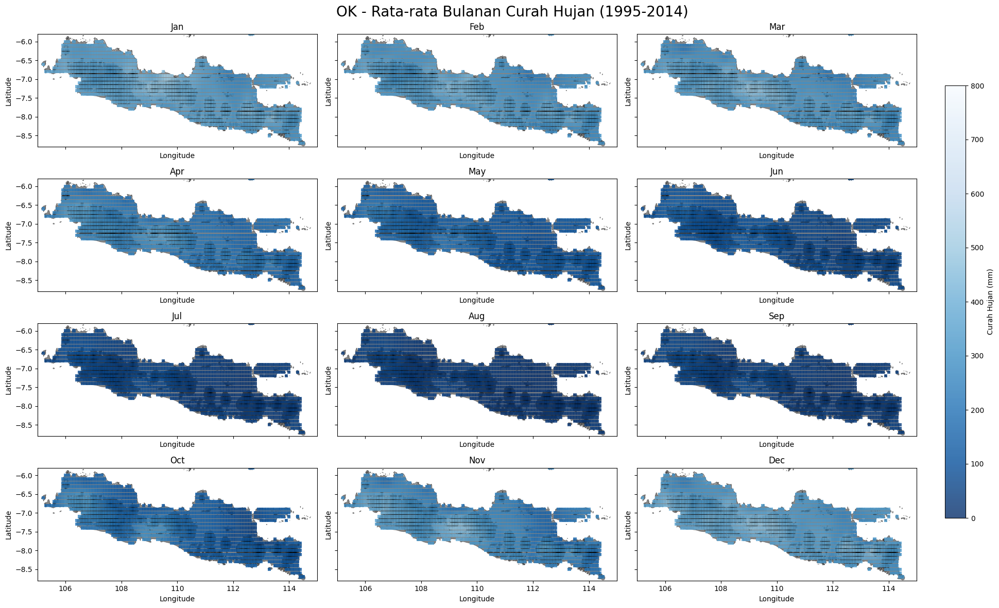

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\659379677.py:47: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


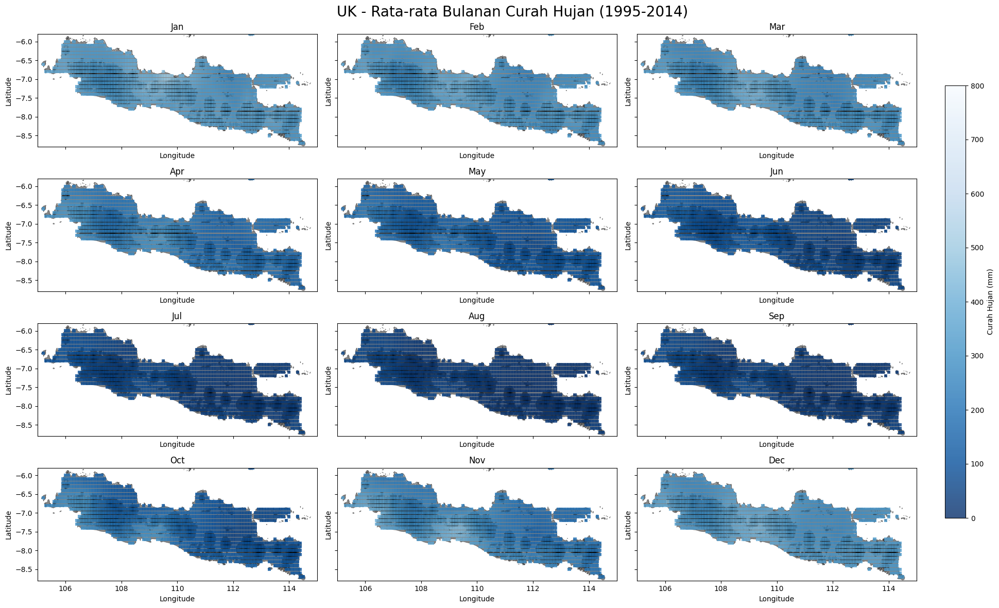

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\659379677.py:47: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


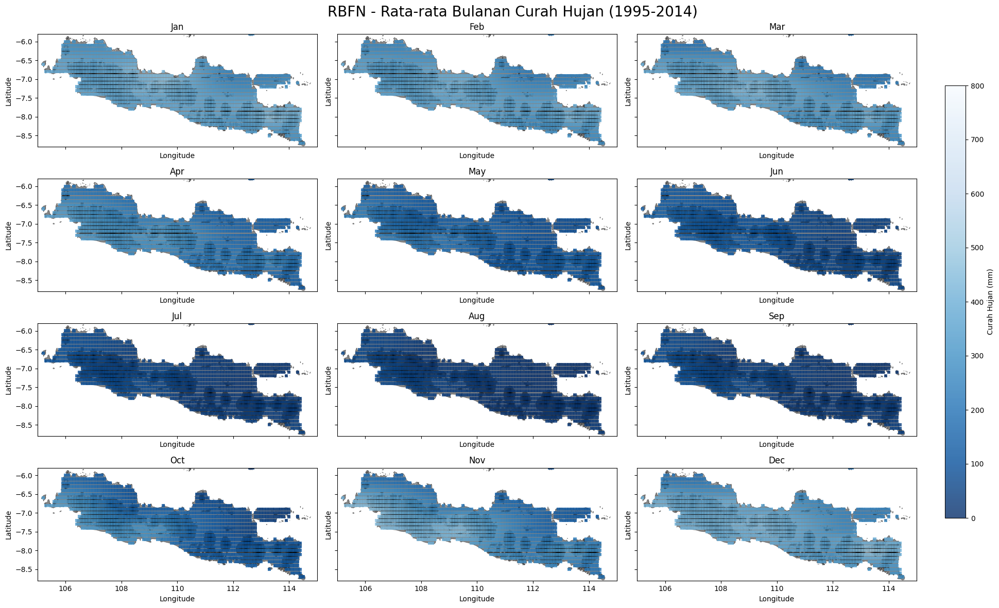

In [173]:
import matplotlib.pyplot as plt
import numpy as np

# List of DataFrames and method names
dfs = [df_ok, df_uk, df_rbf]
method_names = ['OK', 'UK', 'RBFN']
jawa_img = mpimg.imread('JAWA.png')  # Make sure this is loaded or adjust as needed
jawa_nodem_img = mpimg.imread('Jawa_nodem.png')
jawa_extent = [minx, maxx, miny, maxy]

months = range(1, 13)
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

for df, method in zip(dfs, method_names):
    # Calculate monthly mean rainfall (averaged over all years) for each grid point
    monthly_means = df.groupby(['month', 'lon', 'lat'])['rainfall'].mean().reset_index()

    fig, axes = plt.subplots(4, 3, figsize=(20, 12), sharex=True, sharey=True)
    axes = axes.flatten()

    for i, month in enumerate(months):
        ax = axes[i]
        data = monthly_means[monthly_means['month'] == month]
        ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        sc = ax.scatter(
            data['lon'], data['lat'],
            c=data['rainfall'],
            cmap='Blues_r',
            vmin=0, vmax=vmax,
            marker='s', s=20,
            edgecolors='none', zorder=2,
            alpha=0.8
        )
        ax.set_title(month_names[i])
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')

    # Hide any unused subplots
    for i in range(len(months), len(axes)):
        axes[i].axis('off')

    fig.suptitle(f'{method} - Rata-rata Bulanan Curah Hujan (1995-2014)', fontsize=20)
    cbar = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    fig.colorbar(sc, cax=cbar, orientation='vertical', label='Curah Hujan (mm)')
    plt.tight_layout(rect=[0, 0, 0.9, 1])
    plt.savefig(f'{method}_results/Masked/{method}_MonthlyMeanRainfall_DEM.png', dpi=300, bbox_inches='tight')
    plt.show()

#### MAE Grid Data Point

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:53: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])
C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])
C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:139: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


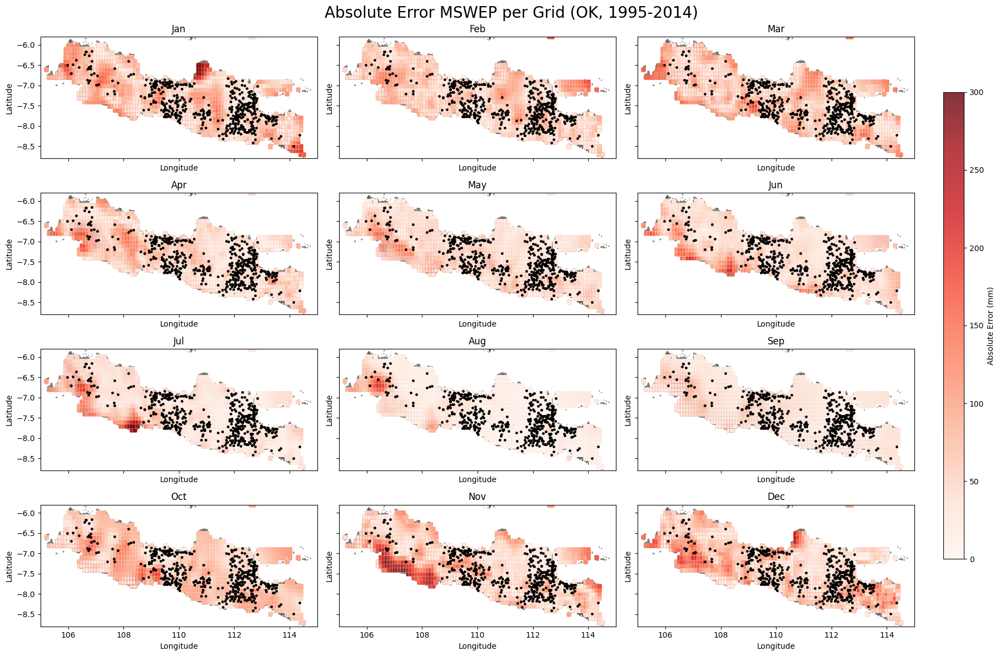

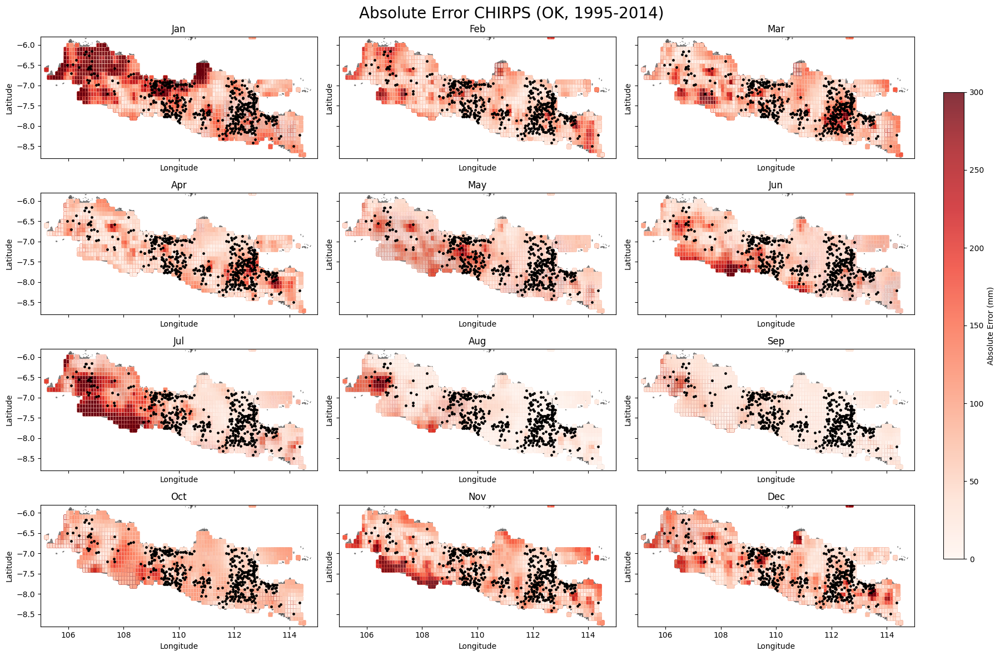

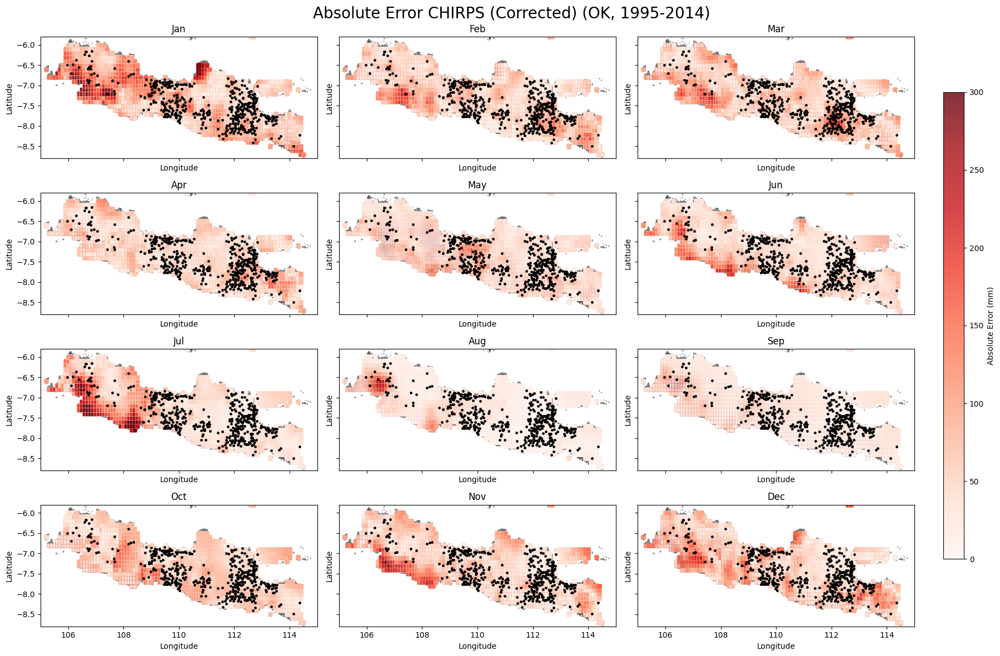

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:53: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])
C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])
C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:139: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


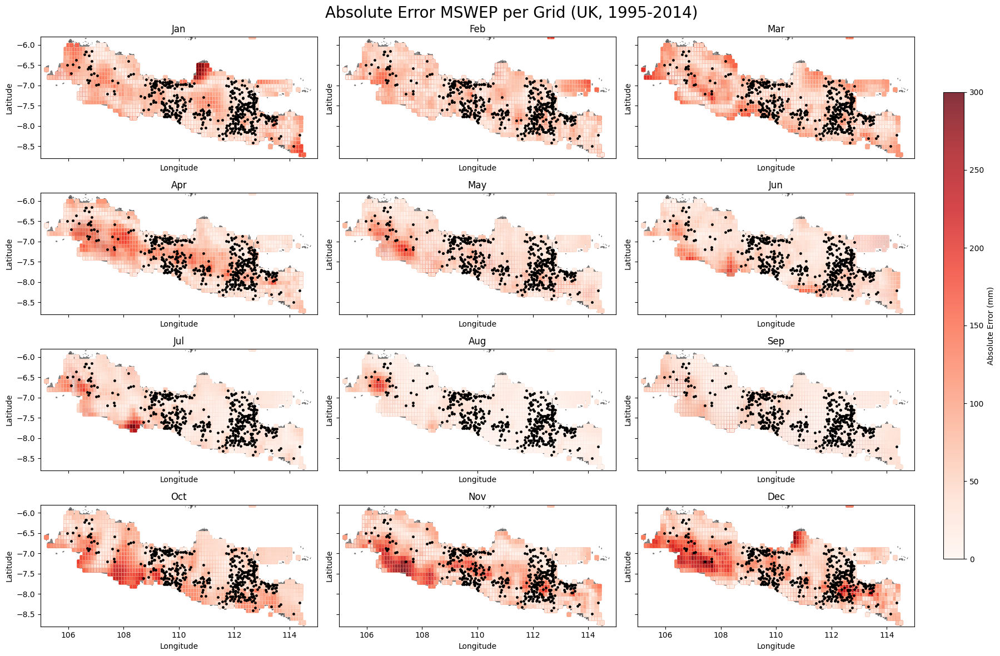

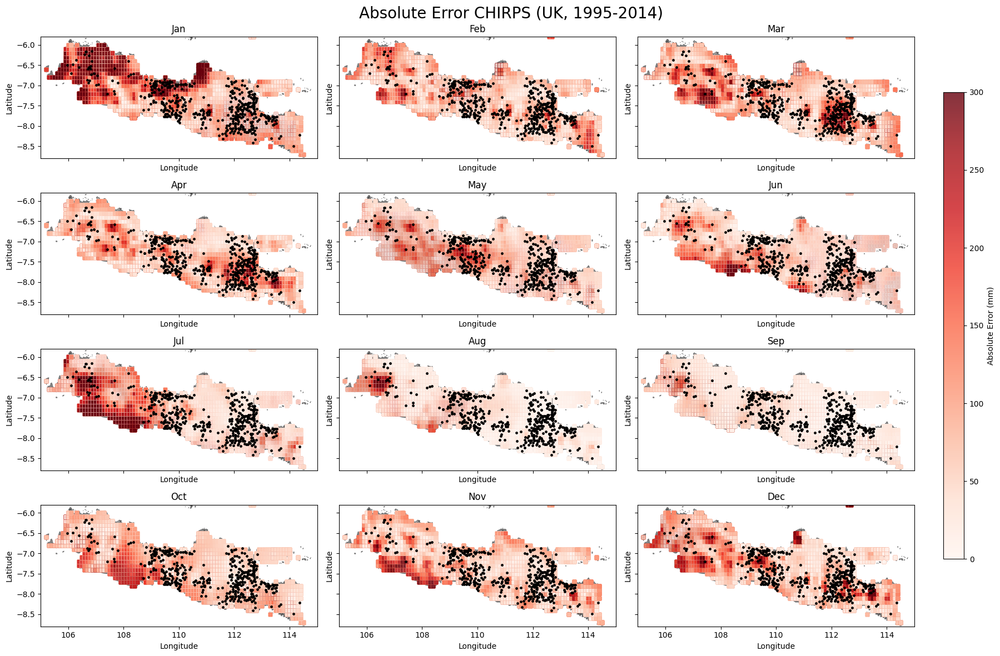

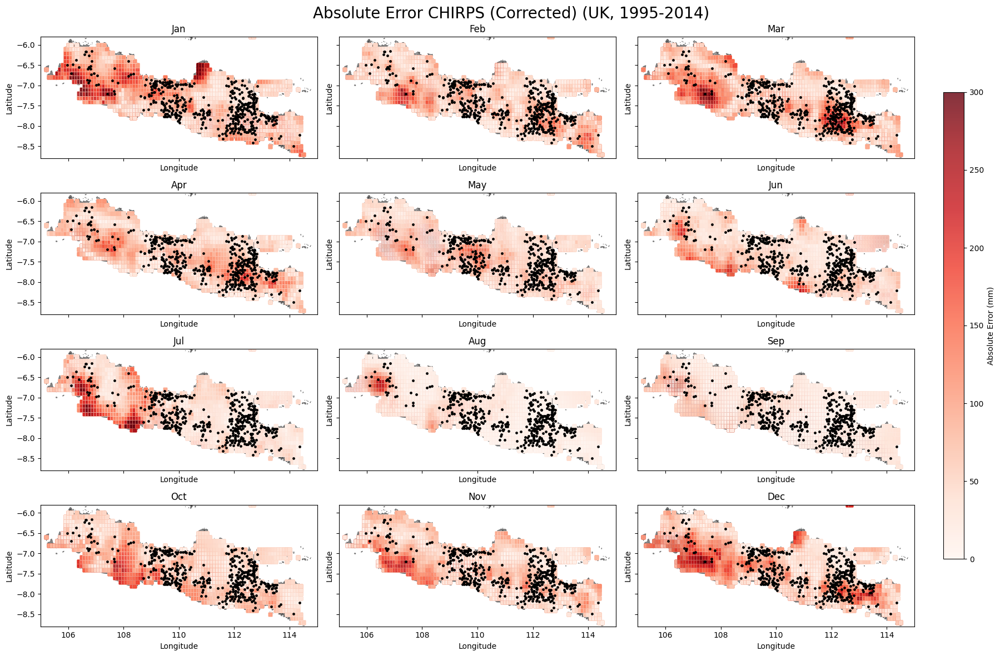

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:53: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])
C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])
C:\Users\allam\AppData\Local\Temp\ipykernel_22436\2558060965.py:139: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


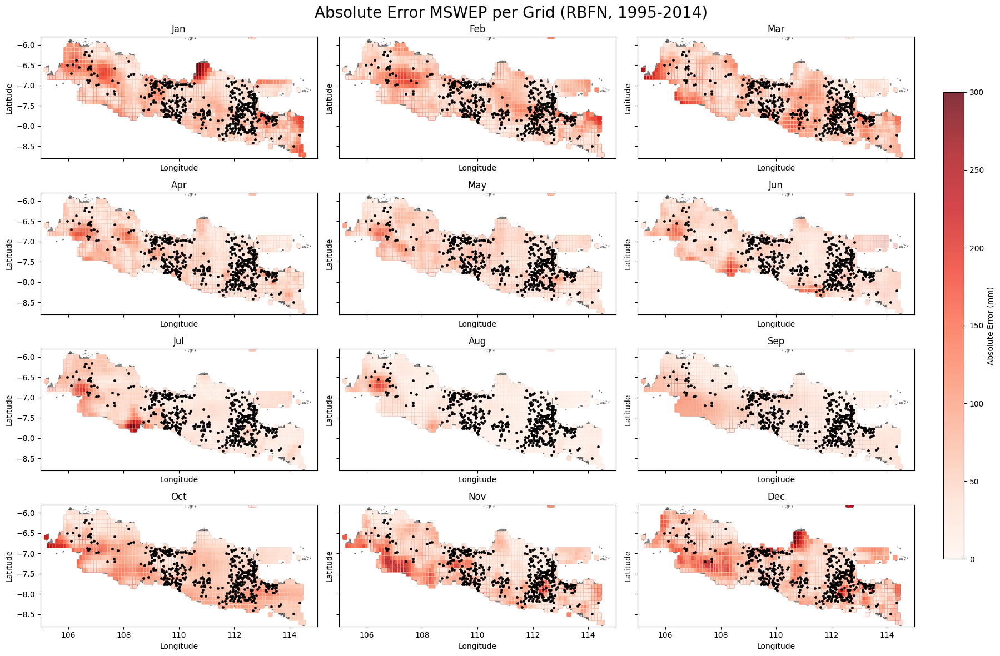

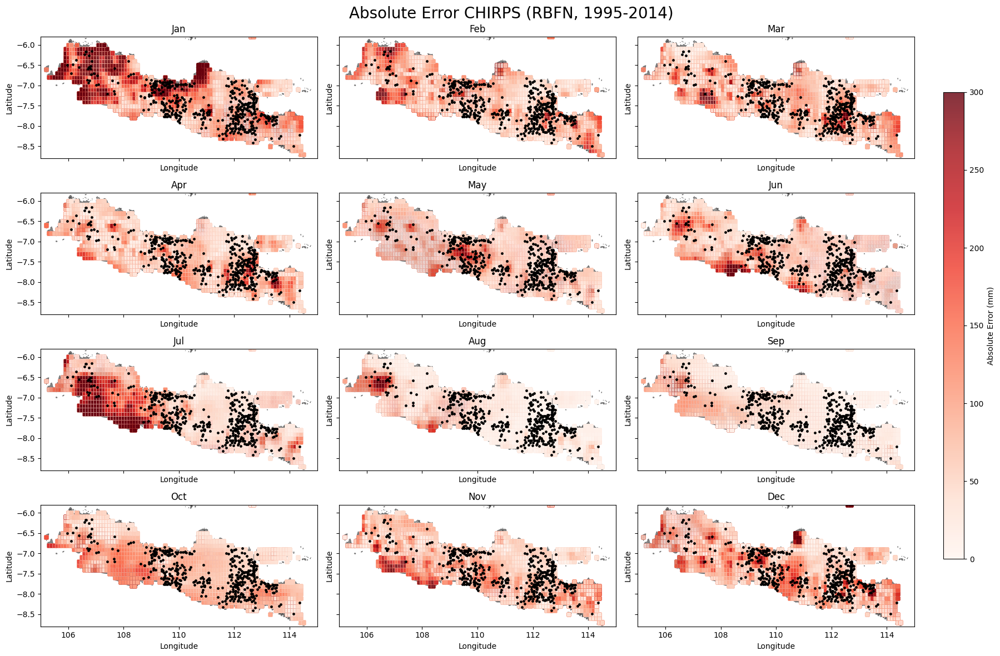

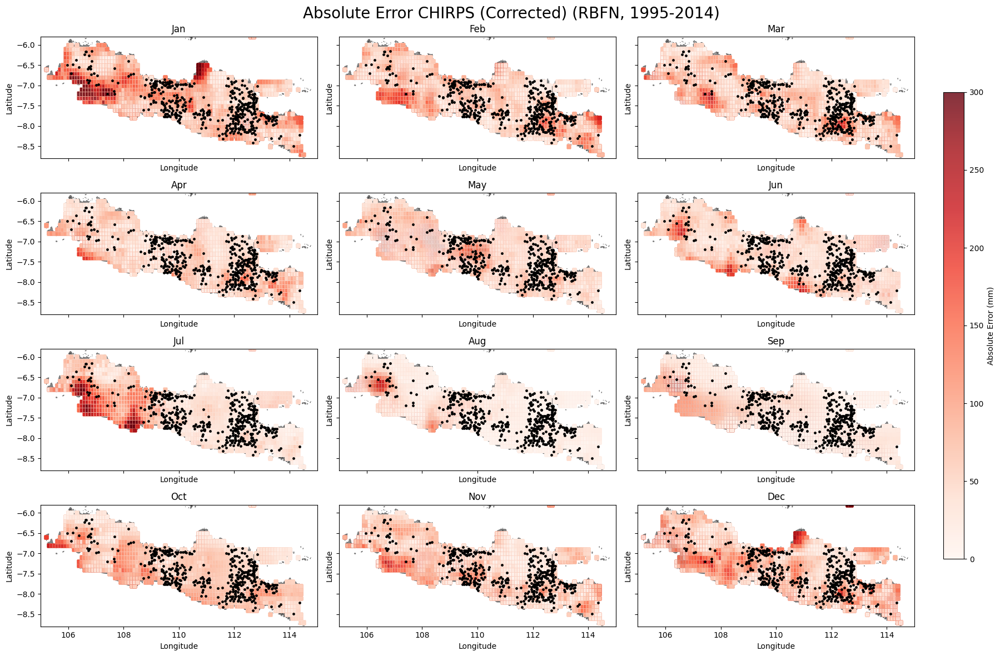

In [178]:
import matplotlib.pyplot as plt
import numpy as np

# Choose which DataFrame and method to plot
for df, method in zip([df_ok, df_uk, df_rbf], ['OK', 'UK', 'RBFN']):
    # Calculate absolute errors if not already present
    df['abs_err_mswep'] = df['bias_mswep'].abs()
    df['abs_err_chirps'] = df['bias_chirps'].abs()
    df['abs_err_chirps_qm'] = df['bias_chirps_qm'].abs()

    months = range(1, 13)
    month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

    # Plot for MSWEP
    fig, axes = plt.subplots(4, 3, figsize=(18.5, 12), sharex=True, sharey=True)
    axes = axes.flatten()
    for i, month in enumerate(months):
        ax = axes[i]
        data = df[df['month'] == month]
        ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        sc = ax.scatter(
            data['lon'], data['lat'],
            c=data['abs_err_mswep'],
            cmap='Reds',
            marker='s',
            s=20,
            #edgecolors='black',
            zorder=2,
            alpha=0.8,
            vmin=0,
            vmax=300
        )
        ax.scatter(
            station_df['lon'], station_df['lat'],
            marker='o',
            facecolors='black',
            #edgecolors='black',
            s=5,
            linewidths=1.2,
            zorder=5,
            label='Station'
        )
        ax.set_title(f"{month_names[i]}")
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
    for i in range(len(months), len(axes)):
        axes[i].axis('off')
    fig.suptitle(f'Absolute Error MSWEP per Grid ({method}, 1995-2014)', fontsize=20)
    cbar = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    fig.colorbar(sc, cax=cbar, orientation='vertical', label='Absolute Error (mm)')
    plt.tight_layout(rect=[0, 0, 0.9, 1])
    #plt.savefig(f'{method}_results/Masked/{method}_AbsErr_MSWEP_monthly.png', dpi=300, bbox_inches='tight')
    #plt.show()

    # Plot for CHIRPS
    fig, axes = plt.subplots(4, 3, figsize=(18.5, 12), sharex=True, sharey=True)
    axes = axes.flatten()
    for i, month in enumerate(months):
        ax = axes[i]
        data = df[df['month'] == month]
        ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        sc = ax.scatter(
            data['lon'], data['lat'],
            c=data['abs_err_chirps'],
            cmap='Reds',
            marker='s',
            s=20,
            #edgecolors='black',
            zorder=2,
            alpha=0.8,
            vmin=0,
            vmax=300
        )
        ax.scatter(
            station_df['lon'], station_df['lat'],
            marker='o',
            facecolors='black',
            #edgecolors='black',
            s=5,
            linewidths=1.2,
            zorder=5,
            label='Station'
        )
        ax.set_title(f"{month_names[i]}")
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
    for i in range(len(months), len(axes)):
        axes[i].axis('off')
    fig.suptitle(f'Absolute Error CHIRPS ({method}, 1995-2014)', fontsize=20)
    cbar = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    fig.colorbar(sc, cax=cbar, orientation='vertical', label='Absolute Error (mm)')
    plt.tight_layout(rect=[0, 0, 0.9, 1])
    #plt.savefig(f'{method}_results/Masked/{method}_AbsErr_CHIRPS_monthly.png', dpi=300, bbox_inches='tight')
    #plt.show()

     # Plot for CHIRPS
    fig, axes = plt.subplots(4, 3, figsize=(18.5, 12), sharex=True, sharey=True)
    axes = axes.flatten()
    for i, month in enumerate(months):
        ax = axes[i]
        data = df[df['month'] == month]
        ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        sc = ax.scatter(
            data['lon'], data['lat'],
            c=data['abs_err_chirps_qm'],
            cmap='Reds',
            marker='s',
            s=20,
            #edgecolors='black',
            zorder=2,
            alpha=0.8,
            vmin=0,
            vmax=300
        )
        ax.scatter(
            station_df['lon'], station_df['lat'],
            marker='o',
            facecolors='black',
            #edgecolors='black',
            s=5,
            linewidths=1.2,
            zorder=5,
            label='Station'
        )
        ax.set_title(f"{month_names[i]}")
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
    for i in range(len(months), len(axes)):
        axes[i].axis('off')
    fig.suptitle(f'Absolute Error CHIRPS (Corrected) ({method}, 1995-2014)', fontsize=20)
    cbar = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    fig.colorbar(sc, cax=cbar, orientation='vertical', label='Absolute Error (mm)')
    plt.tight_layout(rect=[0, 0, 0.9, 1])
    #plt.savefig(f'{method}_results/Masked/{method}_AbsErr_CHIRPS_monthly.png', dpi=300, bbox_inches='tight')
    plt.show()

C:\Users\allam\AppData\Local\Temp\ipykernel_22436\3169118238.py:56: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


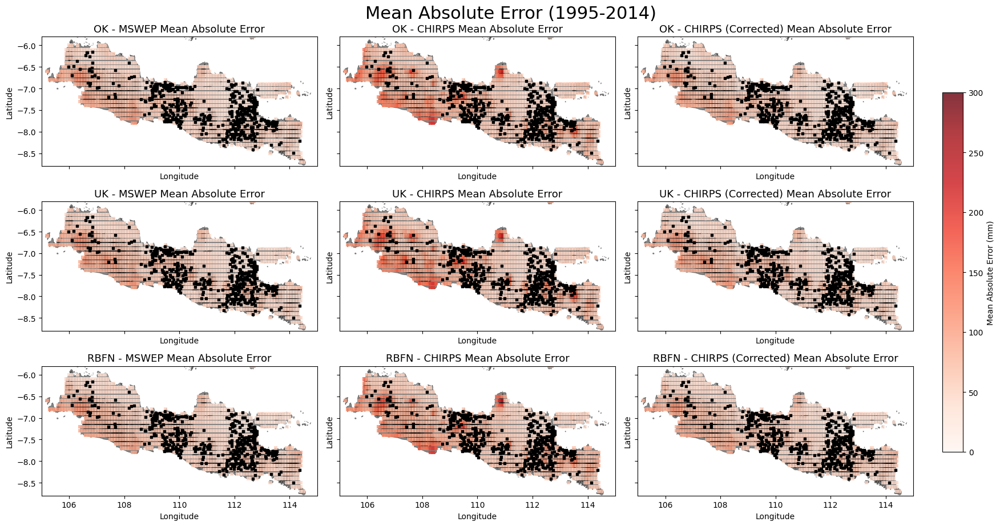

In [179]:
import matplotlib.pyplot as plt
import numpy as np

dfs = [df_ok, df_uk, df_rbf]
method_names = ['OK', 'UK', 'RBFN']
titles = ['MSWEP', 'CHIRPS', 'CHIRPS (Corrected)']

fig, axes = plt.subplots(3, 3, figsize=(18, 9), sharex=True, sharey=True)
jawa_img = mpimg.imread('JAWA.png')  # Make sure this is loaded
jawa_extent = [minx, maxx, miny, maxy]

for row, (df, method) in enumerate(zip(dfs, method_names)):
    # Calculate mean absolute error for each grid point over all years/months
    df['abs_err_mswep'] = df['bias_mswep'].abs()
    df['abs_err_chirps'] = df['bias_chirps'].abs()
    df['abs_err_chirps_qm'] = df['bias_chirps_qm'].abs()
    mean_abs_mswep = df.groupby(['lon', 'lat'])['abs_err_mswep'].mean().reset_index()
    mean_abs_chirps = df.groupby(['lon', 'lat'])['abs_err_chirps'].mean().reset_index()
    mean_abs_chirps_qm = df.groupby(['lon', 'lat'])['abs_err_chirps_qm'].mean().reset_index()
    for col, (mean_abs, title) in enumerate(zip([mean_abs_mswep, mean_abs_chirps, mean_abs_chirps_qm], titles)):
        ax = axes[row, col]
        ax.imshow(jawa_img, extent=jawa_extent, zorder=1, aspect='auto')
        sc = ax.scatter(
            mean_abs['lon'], mean_abs['lat'],
            c=mean_abs[mean_abs.columns[-1]],
            cmap='Reds',
            marker='s',
            s=20,
            edgecolors='none',
            zorder=2,
            alpha=0.8,
            vmin=0,
            vmax=300
        )
        # Overlay station locations
        ax.scatter(
            station_df['lon'], station_df['lat'],
            marker='s',
            facecolors='black',
            #edgecolors='black',
            s=5,
            #linewidths=1.2,
            zorder=5,
            label='Station'
        )
        ax.set_title(f"{method} - {title} Mean Absolute Error", fontsize=13)
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')

# Add colorbars for each column
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
fig.colorbar(sc, cax=cbar_ax, orientation='vertical', label='Mean Absolute Error (mm)')

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.suptitle('Mean Absolute Error (1995-2014)', fontsize=22, y=1.02)
plt.savefig('All_Methods_MeanAbsError_AllYears.png', dpi=300, bbox_inches='tight')
plt.show()